# &#127775;<b>H&M DATA EDA/Personalized-Fashion-Recommendation</b>&#127775;  
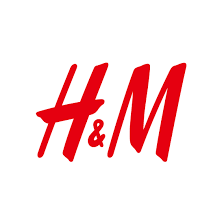
## &#128173;<b>3조:강태원, 민진원, 박지호, 이민선</b>  




## &#128279;<b>Introduction</b>  
현재 진행중인 Kaggle Competition에서 H&M이 제공하는 데이터를 선택했습니다.  
Competiotion의 목적은 H&M 고객 맞춤형 추천시스템을 구축하는 것으로 저희조도 이에 부합하는 EDA를 진행했습니다.  
<b>해당 데이터셋을 선택한 이유</b>는 제품정보, 고객정보, 거래정보 데이터 및 이미지 데이터를 제공 받아 다양한 EDA가 가능하기 때문입니다.  

## &#128279;<b>H&M</b>  
- 스웨덴에 본거지를 둔 다국적 의류유통 브랜드  
- 2014년 기준 55개국 3,500개 지점을 보유  
- 2016년 기준 116,000명 직원을 보유  

## &#128279;<b>Understanding DATA</b>  
- 데이터를 살펴보기 전 [H&M Korea](https://www2.hm.com/ko_kr/index.html) 홈페이지에서 인덱스를 보면 크게 여성, divided, 남성, 신생아/유아, 아동 H&M HOME Sale, 지속가능성으로 구분지었음을 확인할 수 있습니다.  
- 'Divided'라인은 새로운 스타일을 추구하는 10대를 위한 제품군으로 pop culture, music scene, street style에서 영향을 받았습니다.  
- 우선 고객에게 제품을 추천하기 위해서는 어떤 제품이 가장 많이 팔리는지 혹은 가장 적게 팔리는지 등의 제품에 대한 이해가 필요합니다.  
- 고객에 대한 정보도 필요한데 예를들어 유아용 제품을 주로 산 고객이라면 부모 중 한명일 것이고 구매한 제품의 컬러나 사이즈를 분석하면 자녀의 연령대와 성별도 예측할 수 있습니다.  




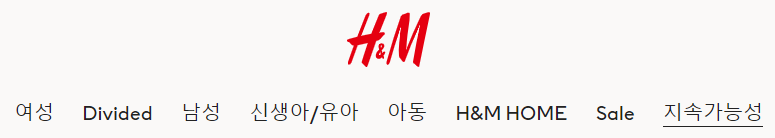

## &#128279;<b>Understanding DATA/Main 3 csv files</b>  
### 3 main csv files + 1 image file
1. <b>articles.csv:</b> 상품 정보 데이터, 25 columns  
> ☆ <b>feature names</b>
       'article_id', 'product_code', 'prod_name', 'product_type_no',
       'product_type_name', 'product_group_name', 'graphical_appearance_no',
       'graphical_appearance_name', 'colour_group_code', 'colour_group_name',
       'perceived_colour_value_id', 'perceived_colour_value_name',
       'perceived_colour_master_id', 'perceived_colour_master_name',
       'department_no', 'department_name', 'index_code', 'index_name',
       'index_group_no', 'index_group_name', 'section_no', 'section_name',
       'garment_group_no', 'garment_group_name', 'detail_desc  
  
2. <b>customer.csv</b>:고객 정보 데이터, 7columns  
> ☆ <b>feature names</b>
       'customer_id', 'FN', 'Active', 'club_member_status',
       'fashion_news_frequency', 'age', 'postal_code'  
  
3. <b>transactions_train.csv</b>:거래 정보 데이터, 4columns  
> ☆ <b>feature names</b>  
       't_dat',	'customer_id',	'article_id',	'price'	'sales_channel_id'  

4. <b>image file</b>:상품 이미지 데이터, .jpg형식  

5. <b>HnM_total_real_final.csv</b>:몇번의 가공을 거친 찐으로 사용할 데이터, 18 columns  
> ☆ <b>feature names</b>
       't_dat', 'customer_id', 'article_id', 'price', 'sales_channel_id',
       'colour_group_name', 'perceived_colour_master_name', 'index_group_name',
       'department_name', 'garment_group_name', 'club_member_status',
       'fashion_news_frequency', 'age', 'age_segment', 'month', 'year_month',
       'season', 'postal_code
  
### feature discussion
**\[Original feature]**
- t_dat : 주문 날짜 ('2019-09-30' ~ '2018-10-01')  
- customer_id : 고객 id (고객 수 : 974,367 명)  
- article_id : 상품 id (상품 수 : 71,396 가지)  
- price : 상품 가격 (0.000017 ~ 0.591525)  
- sales_channel_id : 판매 루트 (1 또는 2 / 판매 루트에 대한 정확한 정보는 없음)  
- colour_group_name : 컬러명  
- perceived_colour_master_name: 채도명  
- index_group_no : 상품 용도 분류 코드  
- index_group_name : 상품 용도 분류 ('Ladieswear', 'Divided', 'Menswear', 'Sport', 'Baby/Children')  
- department_name: 상품 세부 용도 분류
- garment_group_name : 상품 카테고리 분류명 (총 21개 / ex 'Skirts', 'Knitwear', 'Accessories')  
- club_member_status : 멤버쉽 상태 ('ACTIVE', 'PRE-CREATE', 'LEFT CLUB')  
- fashion_news_frequency : ('Regularly', 'NONE', 'Monthly')  
- age : 나이 (16 ~ 99세)  
- postal_code:우편번호 (암호화되어 있음)

**\[Additional feature]**
- age_segment:연령대(10대, 20대, 30대,...)
- month:주문 월
- year_month:년와 월만 표시(201810)
- season:계절(spring,summer, fall, winter)






---

- H&M 의류는 index_group_name(대분류) -> garment_group_name(소분류)로 갈수록 상세하게 의류를 분류함
- 따라서 index_group_name -> garment_group_name -> age_segment(연령대)를 한번에 확인 가능한 컬럼('idx_garment_age')을 별도로 생성함  

---

In [ ]:
#함수 파일 경로 확인 
#import os
#print(os.getcwd())
#print(os.listdir(os.getcwd()))

/content/sample_data/kaggle


- Kaggle API를 활용한 데이터 다운로드    

In [ ]:
#!pip install kaggle #kaggle 설치
from google.colab import files
files.upload()

Saving kaggle.json to kaggle (1).json


{'kaggle.json': b'{"username":"mindy22","key":"aed7e86f05d57c2badb5c4d127612f6c"}'}

In [ ]:
!mkdir -p ~/.kaggle #경로 설정 
!cp kaggle.json ~/.kaggle/
# Permission Warning 이 일어나지 않도록 
!chmod 600 ~/.kaggle/kaggle.json
# 본인이 참가한 모든 대회 보기 
!kaggle competitions list

ref                                            deadline             category            reward  teamCount  userHasEntered  
---------------------------------------------  -------------------  ---------------  ---------  ---------  --------------  
contradictory-my-dear-watson                   2030-07-01 23:59:00  Getting Started     Prizes         58           False  
gan-getting-started                            2030-07-01 23:59:00  Getting Started     Prizes         90           False  
store-sales-time-series-forecasting            2030-06-30 23:59:00  Getting Started  Knowledge       1060           False  
tpu-getting-started                            2030-06-03 23:59:00  Getting Started  Knowledge        169           False  
digit-recognizer                               2030-01-01 00:00:00  Getting Started  Knowledge       1919           False  
titanic                                        2030-01-01 00:00:00  Getting Started  Knowledge      14265           False  
house-pr

In [ ]:
!pip uninstall -y kaggle
!pip install --upgrade pip
!pip install kaggle==1.5.6

Found existing installation: kaggle 1.5.6
Uninstalling kaggle-1.5.6:
  Successfully uninstalled kaggle-1.5.6
  Using cached kaggle-1.5.6-py3-none-any.whl


In [ ]:
!kaggle competitions download -c h-and-m-personalized-fashion-recommendations

h-and-m-personalized-fashion-recommendations.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
%cd /content/sample_data/kaggle
!unzip -qq "/content/sample/h-and-m-personalized-fashion-recommendations.zip" #zip 파일 open 

/content/sample_data/kaggle
unzip:  cannot find or open /content/sample/h-and-m-personalized-fashion-recommendations.zip, /content/sample/h-and-m-personalized-fashion-recommendations.zip.zip or /content/sample/h-and-m-personalized-fashion-recommendations.zip.ZIP.


In [ ]:
from google.colab import drive  
drive.mount("/content/gdrive", force_remount=True)

Mounted at /content/gdrive


In [ ]:
!pip install plotly

In [ ]:
# 사전에 정의한 함수 모듈 불러오기
from module_eda import missing_data, unique_values #function
from gender_function1 import gender #function

# 라이브러리 불러오기
from PIL import Image
from pylab import rcParams
import numpy as np
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import math
import seaborn as sns

ModuleNotFoundError: ignored

### 📌loading datasets
- article_id 데이터타입 str로 변경 

In [ ]:
articles = pd.read_csv("/content/gdrive/MyDrive/kaggle/hnm/data/articles.csv", dtype={'article_id': str})
customers = pd.read_csv("/content/gdrive/MyDrive/kaggle/hnm/data/customers.csv")
transactions = pd.read_csv("/content/gdrive/MyDrive/kaggle/hnm/data/transactions_train.csv", dtype={'article_id': str})

NameError: ignored

In [ ]:
articles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105542 entries, 0 to 105541
Data columns (total 25 columns):
 #   Column                        Non-Null Count   Dtype 
---  ------                        --------------   ----- 
 0   article_id                    105542 non-null  object
 1   product_code                  105542 non-null  int64 
 2   prod_name                     105542 non-null  object
 3   product_type_no               105542 non-null  int64 
 4   product_type_name             105542 non-null  object
 5   product_group_name            105542 non-null  object
 6   graphical_appearance_no       105542 non-null  int64 
 7   graphical_appearance_name     105542 non-null  object
 8   colour_group_code             105542 non-null  int64 
 9   colour_group_name             105542 non-null  object
 10  perceived_colour_value_id     105542 non-null  int64 
 11  perceived_colour_value_name   105542 non-null  object
 12  perceived_colour_master_id    105542 non-null  int64 
 13 

In [ ]:
missing_data(articles) #결측치 확인 

,Total,Percent
detail_desc,416,0.394156
perceived_colour_master_name,0,0.000000
garment_group_name,0,0.000000
garment_group_no,0,0.000000
section_name,0,0.000000
section_no,0,0.000000
index_group_name,0,0.000000
index_group_no,0,0.000000
index_name,0,0.000000
index_code,0,0.000000


- 전반적으로 결측치 없음
- detail_desc에 대한 결측치는 약 40%이므로 해당 feature를 제거하고자 함  
(내용 기반 필터링을 하지 않을 예정이므로 해당 feature를 제거해도 된다고 판단함)

In [ ]:
unique_values(articles) #피처별 고유 값 확인

,Total,Uniques
article_id,105542,105542
product_code,105542,47224
prod_name,105542,45875
product_type_no,105542,132
product_type_name,105542,131
product_group_name,105542,19
graphical_appearance_no,105542,30
graphical_appearance_name,105542,30
colour_group_code,105542,50
colour_group_name,105542,50


In [ ]:
transactions.info()

NameError: ignored

In [ ]:
missing_data(transactions)

In [ ]:
unique_values(transactions)

- 고유값이 적은게 상위 클래스가 될 가능성이 크므로 상위 피쳐별로 데이터를 뜯어보는게 유리할 듯 함

- 각 데이터는 h&m 공식 온라인 스토어 데이터에서 나온 것으로 판단함
[H&M](https://www2.hm.com/en_us/divided/products/skirts.html) 

## Gender 컬럼 생성

In [ ]:

#index_name 컬럼에서 gender를 추출하기 위한 빌드업 
temp = articles.loc[::,['index_name']]
temp = temp.drop_duplicates()
temp

,index_name
0,Ladieswear
3,Lingeries/Tights
11,Baby Sizes 50-98
16,Menswear
28,Ladies Accessories
40,Sport
69,Children Sizes 92-140
78,Divided
81,Children Sizes 134-170
1367,"Children Accessories, Swimwear"


In [ ]:
temp = articles.loc[::,['index_group_name']]
temp = temp.drop_duplicates()
temp

,index_group_name
0,Ladieswear
11,Baby/Children
16,Menswear
40,Sport
78,Divided


In [ ]:
temp = articles.loc[::,['department_name']]
temp = temp.drop_duplicates()
temp

,department_name
0,Jersey Basic
3,Clean Lingerie
6,Tights basic
11,Baby basics
13,Casual Lingerie
...,...
86124,Baby Girl Local Relevance
89528,EQ Divided Blue
89929,Kids Boy Exclusive
90852,Accessories Other


In [ ]:
temp = articles.loc[::,['section_name']]
temp = temp.drop_duplicates()
temp

,section_name
0,Womens Everyday Basics
3,Womens Lingerie
6,"Womens Nightwear, Socks & Tigh"
11,Baby Essentials & Complements
16,Men Underwear
23,Mama
28,Womens Small accessories
40,Men H&M Sport
69,Kids Boy
78,Divided Basics


- 가장 상위 클래스인 ladieswear과 menswear의 하위 클래스들 gender는 구분 할 수 있을 것으로 예상됨

In [ ]:
df_article = articles.apply(gender, axis=1) #gender를 구분한 df_article 생성 
df_article.head()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,detail_desc,gender
0,0108775015,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,9,Black,...,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.,female
1,0108775044,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,10,White,...,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.,female
2,0108775051,108775,Strap top (1),253,Vest top,Garment Upper body,1010017,Stripe,11,Off White,...,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.,female
3,0110065001,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,9,Black,...,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde...",female
4,0110065002,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,10,White,...,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde...",female


### 📌월별 Top 10 이미지 파일 시각화 

In [ ]:
#'t_dat' 데이터 시간대별 정리 
transactions['t_dat'] = pd.to_datetime(transactions['t_dat'], infer_datetime_format=True)
transactions['year'] = transactions['t_dat'].dt.year
transactions['mon'] = transactions['t_dat'].dt.month
transactions['day'] = transactions['t_dat'].dt.day

In [ ]:
transactions.info() #데이터가 잘 변환 됐는지 확인 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31788324 entries, 0 to 31788323
Data columns (total 8 columns):
 #   Column            Dtype         
---  ------            -----         
 0   t_dat             datetime64[ns]
 1   customer_id       object        
 2   article_id        object        
 3   price             float64       
 4   sales_channel_id  int64         
 5   year              int64         
 6   mon               int64         
 7   day               int64         
dtypes: datetime64[ns](1), float64(1), int64(4), object(2)
memory usage: 1.9+ GB


In [ ]:
#월별 Top 10 시각화
at_data = articles[['article_id', 'colour_group_name', 'department_name']]

In [ ]:
def split_month(y:int, m:int):
    y = int(y)
    m = int(m)
    temp = transactions[(transactions['year'] == y) 
                            & (transactions['mon'] == m)][['article_id', 'year', 'mon']]
    val = pd.merge(temp, at_data, how = 'inner', on = 'article_id').reset_index()

    temp = val.copy()
    temp = temp.groupby(by = ['article_id']).agg({'article_id':'count'})
    temp.columns = ['count']
    temp = temp.reset_index()
    temp = temp.sort_values(by = ['count'], ascending=False)
    temp = temp.head(11)
    
    return temp

In [ ]:
split_month_list = []
dt_list = [(2018,9), (2018,10), (2018,11), (2018,12), (2019,1), (2019,2), (2019,3), (2019,4), (2019,5), (2019,6),
            (2019,7), (2019,8), (2019,9), (2019,10), (2019,11), (2019,12), (2020,1), (2020,2), (2020,3), (2020,4),
            (2020,5), (2020,6), (2020,7), (2020,8), (2020,9)]

dt_tuple_list = [("2018-09"),("2018-10"),("2018-11"),("2018-12"),("2019-01"),("2019-02"),("2019-03"),("2019-04"),
                  ("2019-05"),("2019-06"),("2019-07"),("2019-08"),("2019-09"),("2019-10"),("2019-11"),("2019-12"),
                  ("2020-01"),("2020-02"),("2020-03"),("2020-04"),("2020-05"),("2020-06"),("2020-07"),("2020-08"),
                  ("2019-09")]

for y, m in dt_list:
    df_date = split_month(y, m)
    split_month_list.append(df_date)

In [ ]:
print(len(split_month_list)) #인덱스 길이 확인

25


In [ ]:
plt.figure(figsize=(30, 600))
i = 1
for idx in range(24 + 1):
    for j,x in enumerate(split_month_list[idx]['article_id'].to_list()):
        try:
            image = Image.open("/content/sample_data/kaggle/images/" + str(x)[:3]+'/'+ str(x) +".jpg")
            plt.subplot(2 * len(split_month_list), 5, i)
            plt.imshow(image)
            #plt.axis('off')
            plt.title(dt_tuple_list[idx] + " articles: " + x)
            plt.xlabel("Sell Count = "+str(split_month_list[idx]['count'].to_list()[j]))
            i+=1
        except:
            pass

### 📌 제품 이미지를 통한 인사이트 도출
- 월별 top10 제품의 이미지를 확인해 본 결과 전반적으로 계절성을 띄는 제품군이(니트웨어, 수영복 등) 존재
- 색깔도 전반적으로 블랙계열이 많으며 계절성을 띄는 색이 반복적으로 존재하는 것으로 파악됨
- 이후 eda에서는 이를 활용해 기간별(계절 포함) 연령대등 추가 컬럼을 만들어서 좀 더 확실하게 이들의 유사도를 확인해볼 필요성이 있음

---

## 원본 데이터 및 데이터프레임 가공
- 데이터프레임 병합 및 새로운 feature 추가

### 📌 Downsampling Data 
- 해당 데이터 셋이 너무 무거워 필요없는 열은 지우고 기간을 1년치로 한정시킨 뒤 (2018-2019년) random sampling을 사용해 downsampling 함

In [ ]:
#loading data
data = pd.read_csv("/content/gdrive/MyDrive/kaggle/hnm/data/HnM_total_real_final (1).csv", dtype={'article_id': str})
data.head()

,t_dat,customer_id,article_id,price,sales_channel_id,colour_group_name,perceived_colour_master_name,index_group_name,department_name,garment_group_name,club_member_status,fashion_news_frequency,age,age_segment,month,year_month,season,postal_code
0,2019-05-05,cea9635eee2375507deb4f779c139789f0f977b307d262...,629746002,0.030492,Off,Light Blue,Blue,Ladieswear,Swimwear,Swimwear,ACTIVE,NONE,24.0,20.0,5,201905,Spring,4f79b3604d86382b20c7232765d231582af8b231ed97f6...
1,2018-11-11,d2402a86e7d328fa4e72b8c4e805f2e65e0c9228ee9122...,703372001,0.067780,Off,Dark Grey,Grey,Ladieswear,Trouser,Trousers,ACTIVE,NONE,29.0,20.0,11,201811,Fall,5a8fa6a88d7b8746555e3977770e9258d9d85c3919b50b...
2,2018-11-23,4eefe1498be6e8f4cccfda0c66c5237a5b7f217f55007d...,639151001,0.081339,Off,Black,Black,Ladieswear,Outwear,Outdoor,ACTIVE,Regularly,29.0,20.0,11,201811,Fall,6b07bc47d3e8a93edcf52feeb46e0297d097ee6fbfe927...
3,2019-03-27,f92ce9deacdea96beecd794102ead86fc8f51ebca6dbe7...,705988013,0.025407,On,Black,Black,Divided,Trousers,Trousers,ACTIVE,NONE,21.0,20.0,3,201903,Spring,88e9ca0208a47f7bf9c0e9a9df396efc8ae67751b4b9e9...
4,2019-05-26,1bbff67bfe2cc8e89cbd17d95a89e63599197e9bc1b4f7...,758200002,0.044068,Off,Black,Black,Ladieswear,Blouse & Dress,Blouses,ACTIVE,NONE,25.0,20.0,5,201905,Spring,3689515896050f52234989a25d4e7250285f52b2d596e5...


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4971778 entries, 0 to 4971777
Data columns (total 18 columns):
 #   Column                        Dtype  
---  ------                        -----  
 0   t_dat                         object 
 1   customer_id                   object 
 2   article_id                    object 
 3   price                         float64
 4   sales_channel_id              object 
 5   colour_group_name             object 
 6   perceived_colour_master_name  object 
 7   index_group_name              object 
 8   department_name               object 
 9   garment_group_name            object 
 10  club_member_status            object 
 11  fashion_news_frequency        object 
 12  age                           float64
 13  age_segment                   float64
 14  month                         int64  
 15  year_month                    int64  
 16  season                        object 
 17  postal_code                   object 
dtypes: float64(3), int64(2

### 📌기간별 매출
#### 1.월별매출

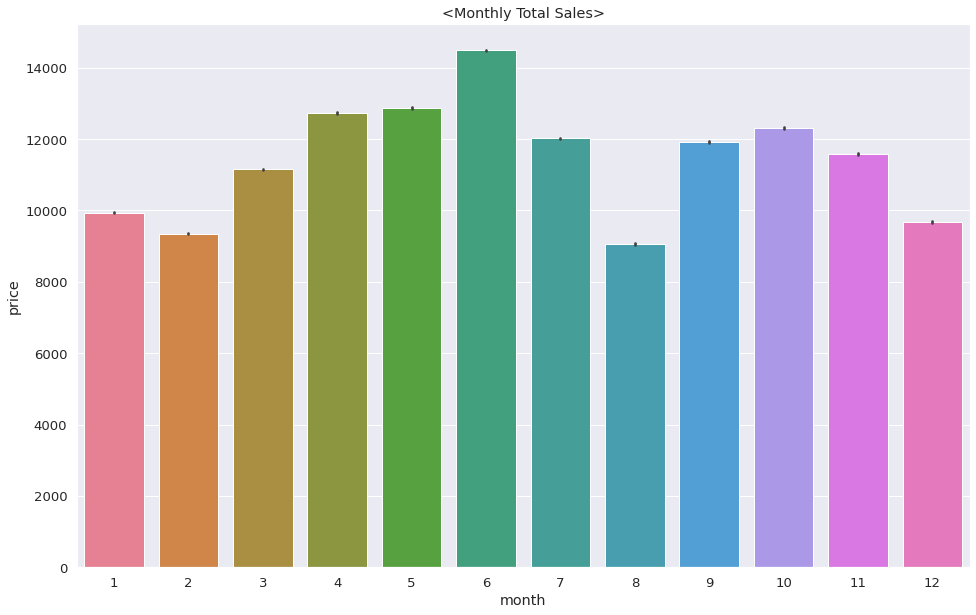

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(16,10))

plt.title('<Monthly Total Sales>')

plt.xlabel('Month')
plt.ylabel('Total Price sum')

sns.barplot(data=data, x='month', y='price', estimator=np.sum, palette='husl')

- 6월의 아이템 판매량이 매우 높아 해당 원인을 추후 파악하고자 함

### 📌계절별 매출

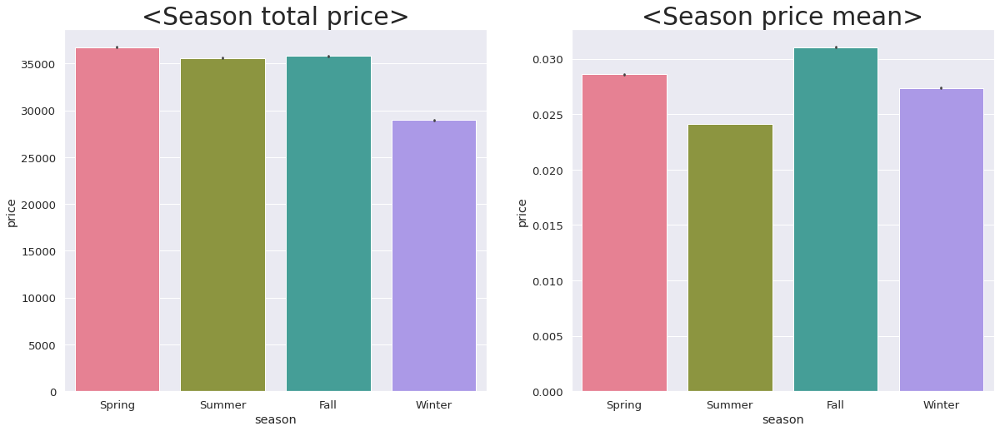

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)
plt.title('<Season total price>', fontsize=30)
sns.barplot(data=data, x='season', y='price', estimator=np.sum, order = ['Spring', 'Summer', 'Fall', 'Winter'], palette='husl')

plt.subplot(1,2,2)
plt.title('<Season price mean>', fontsize=30)
sns.barplot(data=data, x='season', y='price', order = ['Spring', 'Summer', 'Fall', 'Winter'], palette='husl')

- 총 판매 가격 기준으로는 Spring 시즌이 가장 높은 것으로 나타남
- 평균 가격을 구했을 때는 Fall 시즌이 가장 높은 단가를 보임
- Fall, Winter 시즌의 아이템 가격이 높은 것으로 판단됨 (니트류, 아우터 등)

In [ ]:
data.groupby('season')['price'].sum()

season
Fall      35800.390661
Spring    36747.376254
Summer    35566.247271
Winter    28974.310492
Name: price, dtype: float64

### 📌 Customer Age에 따른 시각화  
<b>Customer Age 요약</b>
- age의 최대값 : 99 세
- age의 최소값 : 16 세
- 회원 가입 시 나이 설정할 때 본인 나이와 상관없이 아무나이나 설정 가능하므로 99라는 숫자가 나올 수 있음
(홈페이지 확인함)
- age 평균 : 약 36.5 세
- age 중간값 : 약 32 세


### 1.연령에 대한 전반적인 파악 
- 20대의 총 구매 금액 : 53,856
- 20대의 평균
- 20대는 고객이 가장 많으므로 총 구매 금액은 가장 높음
- 평균 금액이 가장 높은 연령대는 80대

In [ ]:
data['age'].describe()

count    4.971778e+06
mean     3.651917e+01
std      1.291216e+01
min      1.600000e+01
25%      2.600000e+01
50%      3.200000e+01
75%      4.800000e+01
max      9.900000e+01
Name: age, dtype: float64

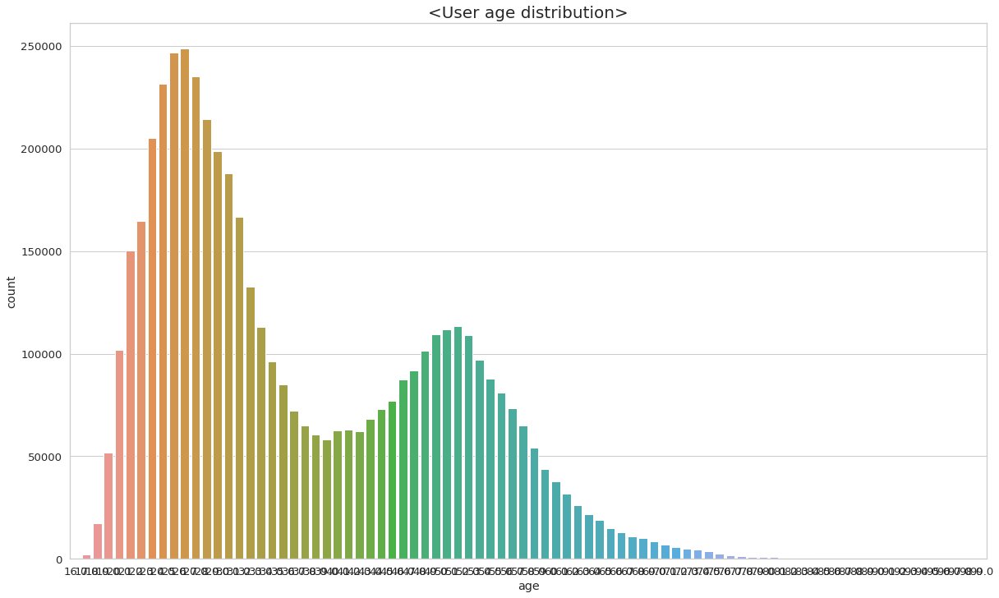

In [ ]:
plt.figure(figsize=(20, 12))
plt.title('<User age distribution>', fontsize=20)
sns.countplot(data=data, x='age')

Text(0.5, 0, 'User Age Segment')

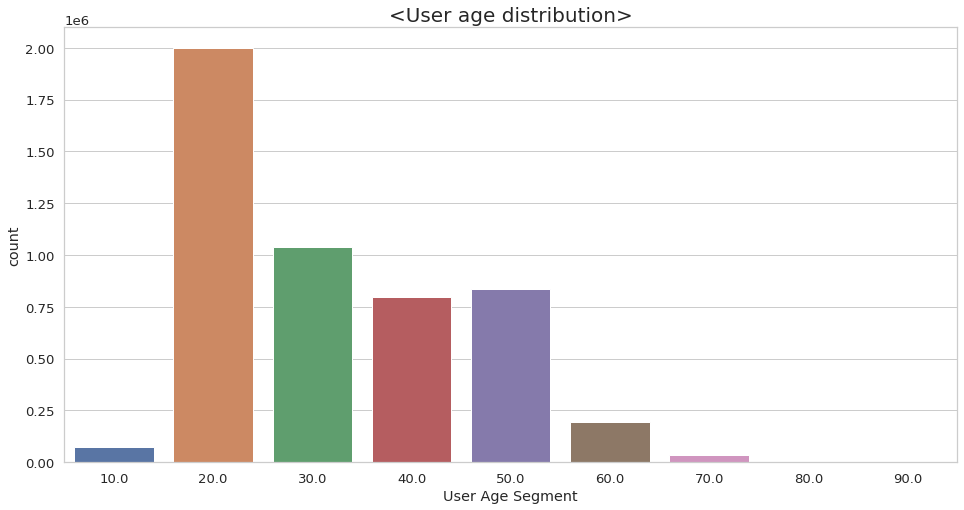

In [ ]:
plt.figure(figsize=(16, 8))
plt.title('<User age distribution>', fontsize=20)
sns.countplot(data=data, x='age_segment')
plt.xlabel('User Age Segment')

- 연령별 고객은 20대가 가장 많음
- 99세의 연령도 존재함  
(회원 가입 시 나이 설정할 때 본인 나이와 상관없이 아무나이나 설정 가능하므로 99라는 숫자가 나올 수 있음 (홈페이지 확인함))

In [ ]:
data.groupby('age_segment')['customer_id'].count()

age_segment
10.0      71679
20.0    1998839
30.0    1037896
40.0     796716
50.0     837125
60.0     193956
70.0      32838
80.0       2488
90.0        241
Name: customer_id, dtype: int64

In [ ]:
for i in [10, 20, 30, 40, 50, 60, 70 ,80, 90]:
    print('{}대의 구매 비율 : {:.4f}%'.format(i, (len(data[data['age_segment'] == i]) / len(data))*100))

10대의 구매 비율 : 1.4417%
20대의 구매 비율 : 40.2037%
30대의 구매 비율 : 20.8758%
40대의 구매 비율 : 16.0248%
50대의 구매 비율 : 16.8375%
60대의 구매 비율 : 3.9011%
70대의 구매 비율 : 0.6605%
80대의 구매 비율 : 0.0500%
90대의 구매 비율 : 0.0048%


Text(0.5, 0, 'Age_Segment')

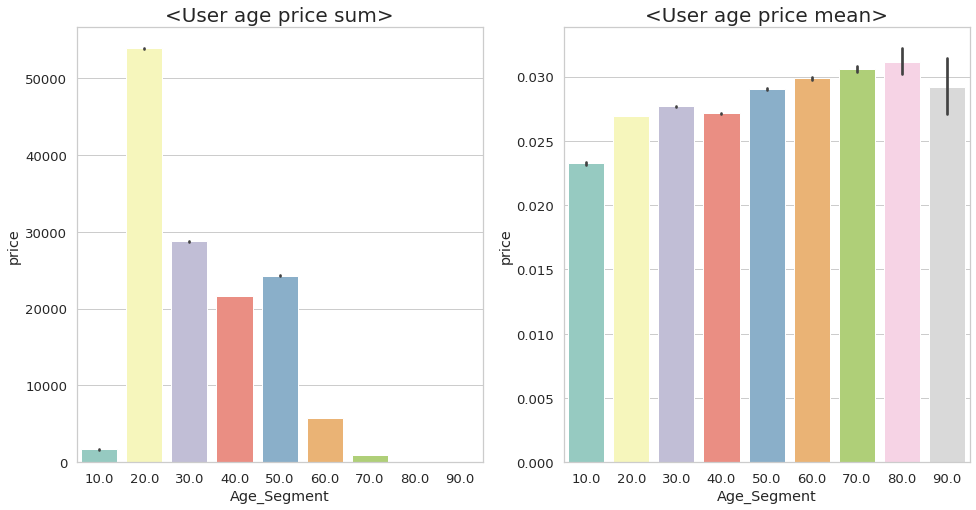

In [ ]:
plt.figure(figsize=(16, 8))

plt.subplot(1,2,1)
plt.title('<User age price sum>', fontsize=20)
sns.barplot(data=data, x='age_segment', y='price', estimator=np.sum, palette="Set3")
plt.xlabel('Age_Segment')


plt.subplot(1,2,2)
plt.title('<User age price mean>', fontsize=20)
sns.barplot(data=data, x='age_segment', y='price', palette="Set3")
plt.xlabel('Age_Segment')

- 20대 고객의 수가 많으므로 총 판매 가격은 20대가 가장 높음
- 아이템 구매 단가는 80대가 가장 높음
- 80\~90대의 고객의 구매 단가는 비교적 편차가 큼  
(가설 : 80\~90대로 나이를 설정한 고객들은 비슷한 패턴을 보일 것으로 예상됨)

In [ ]:
data_age_price = data.groupby('age_segment')['price'].sum()
data_age_price

age_segment
10.0     1666.865593
20.0    53856.341746
30.0    28749.349661
40.0    21625.371407
50.0    24310.602644
60.0     5790.703136
70.0     1004.538898
80.0       77.519644
90.0        7.031949
Name: price, dtype: float64

In [ ]:
data_age_price_mean = data.groupby('age_segment')['price'].mean()
data_age_price_mean

age_segment
10.0    0.023255
20.0    0.026944
30.0    0.027700
40.0    0.027143
50.0    0.029041
60.0    0.029856
70.0    0.030591
80.0    0.031157
90.0    0.029178
Name: price, dtype: float64

### 2. 연령별 선호도

- 연령별 선호도에서 'Jersey Fancy'의 비율이 매우 높음
  - Jersey Fancy는 옷 종류에 상관없이 원단에 의한 분류이므로 매우 광범위한 분포를 가진 카테고리임
  - Jersey Fancy : 옷에 패턴이나 모양의 변형이 있는 아이템
  - Jersey Basic : 기본 무지의 단색 계열 아이템

#### 2-1. 10대 

In [ ]:
df_tens_product=data[data['age_segment'] == 10.0]['garment_group_name']
df_age_tens=data[data['age_segment'] == 10.0]['colour_group_name']

Text(0, 0.5, 'item')

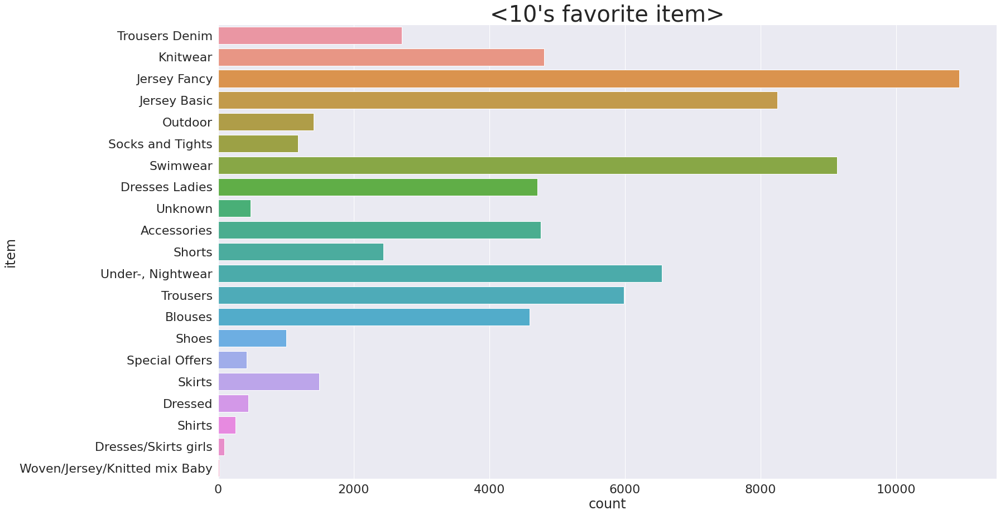

In [ ]:
sns.set(font_scale=2)
plt.figure(figsize=(25,15))
plt.title("<10's favorite item>", fontsize=40)
sns.countplot(data=df_tens_product, y=df_tens_product)
plt.ylabel('item')

- 10대가 가장 선호하는 아이템 : Jersey Fancy, Swimwear, Jersey Basic

Text(0, 0.5, 'color')

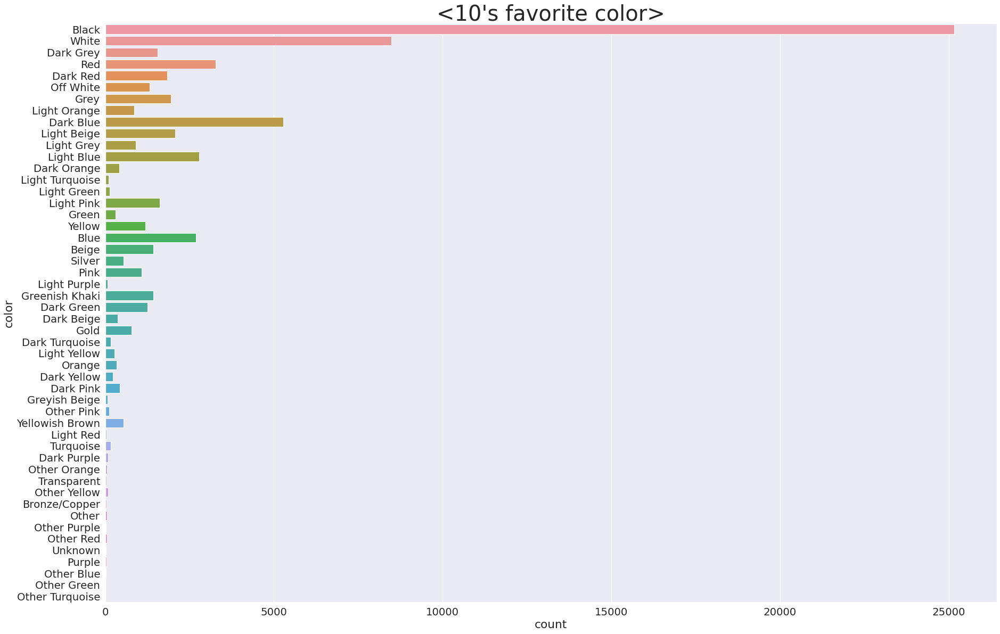

In [ ]:
sns.set(font_scale=1.8)
plt.figure(figsize=(30,20))
plt.title("<10's favorite color>", fontsize=40)
sns.countplot(data=df_age_tens, y=df_age_tens)
plt.ylabel('color')

- 10대가 가장 선호하는 색상 : Black, White, Dark Blue

#### 2-2.20대

In [ ]:
df_twenteen_color=data[data['age_segment'] == 20.0]['colour_group_name']
df_twenteen_product=data[data['age_segment'] == 20.0]['garment_group_name']

Text(0, 0.5, 'item')

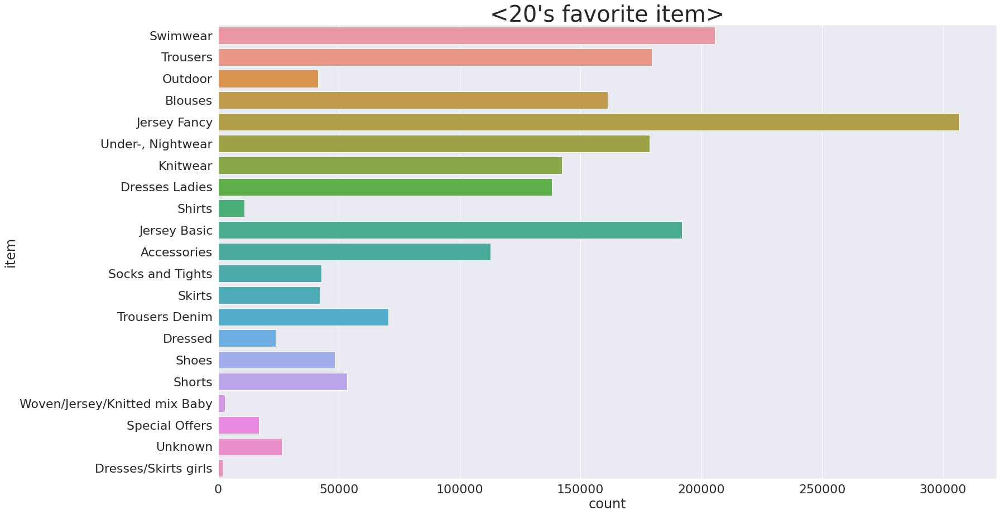

In [ ]:
sns.set(font_scale=2)
plt.figure(figsize=(25,15))
plt.title("<20's favorite item>", fontsize=40)
sns.countplot(data=df_twenteen_product, y=df_twenteen_product)
plt.ylabel('item')

- 20대가 가장 선호하는 아이템 : Jersey Fancy, Swimwear, Jersey Basic

Text(0, 0.5, 'color')

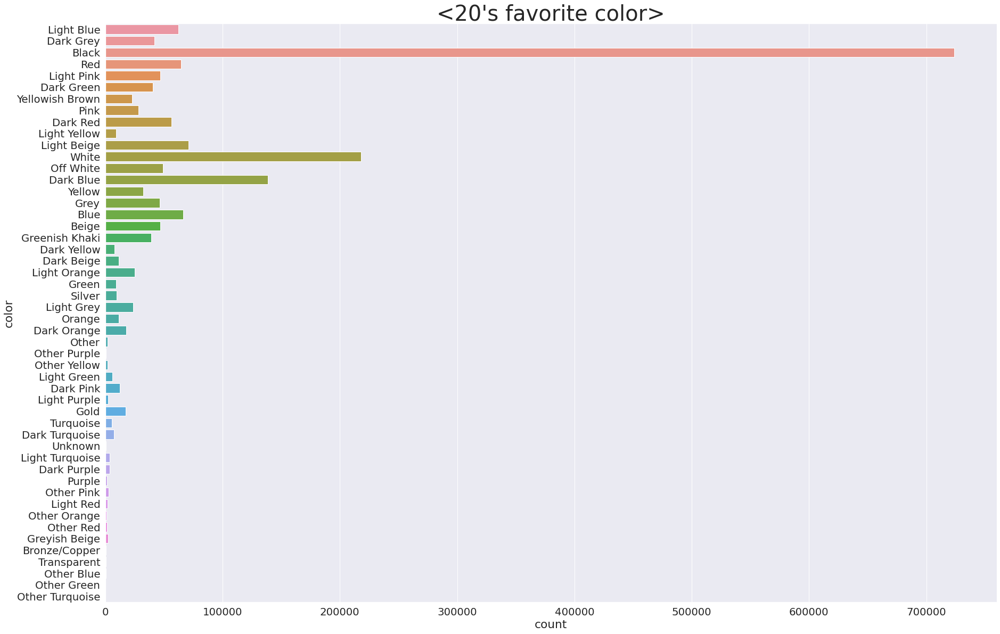

In [ ]:
sns.set(font_scale=1.8)
plt.figure(figsize=(30,20))
plt.title("<20's favorite color>", fontsize=40)
sns.countplot(data=df_twenteen_color, y=df_twenteen_color)
plt.ylabel('color')

- 20대가 가장 선호하는 색상 : Black, White, Dark Blue

#### 2-3.30대 

In [ ]:
df_thirty_product=data[data['age_segment'] == 30.0]['garment_group_name']
df_thirty_color=data[data['age_segment'] == 30.0]['colour_group_name']

Text(0, 0.5, 'item')

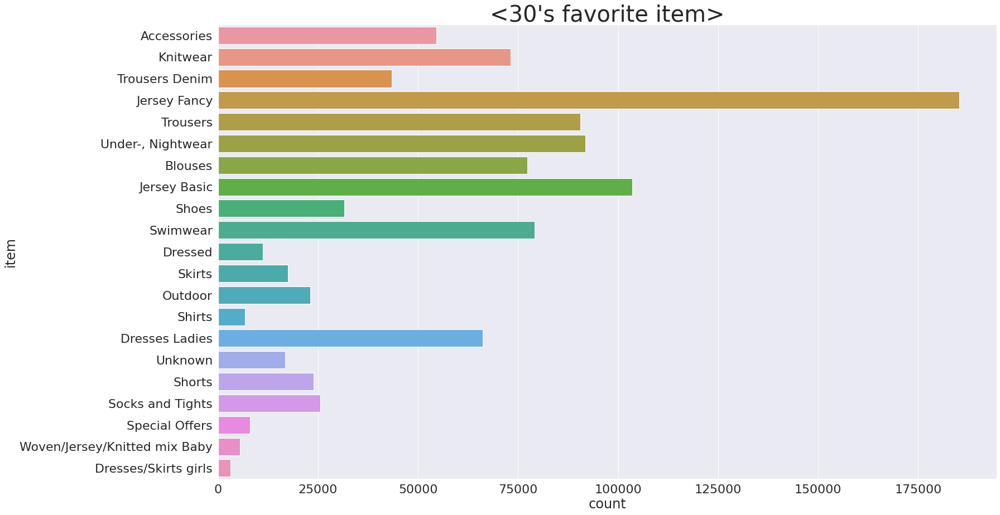

In [ ]:
sns.set(font_scale=2)
plt.figure(figsize=(25,15))
plt.title("<30's favorite item>", fontsize=40)
sns.countplot(data=df_thirty_product, y=df_thirty_product)
plt.ylabel('item')

- 30대가 가장 선호하는 아이템 : Jersey Fancy, Jersey Basic, Under-Nightwear, Trousers

Text(0, 0.5, 'color')

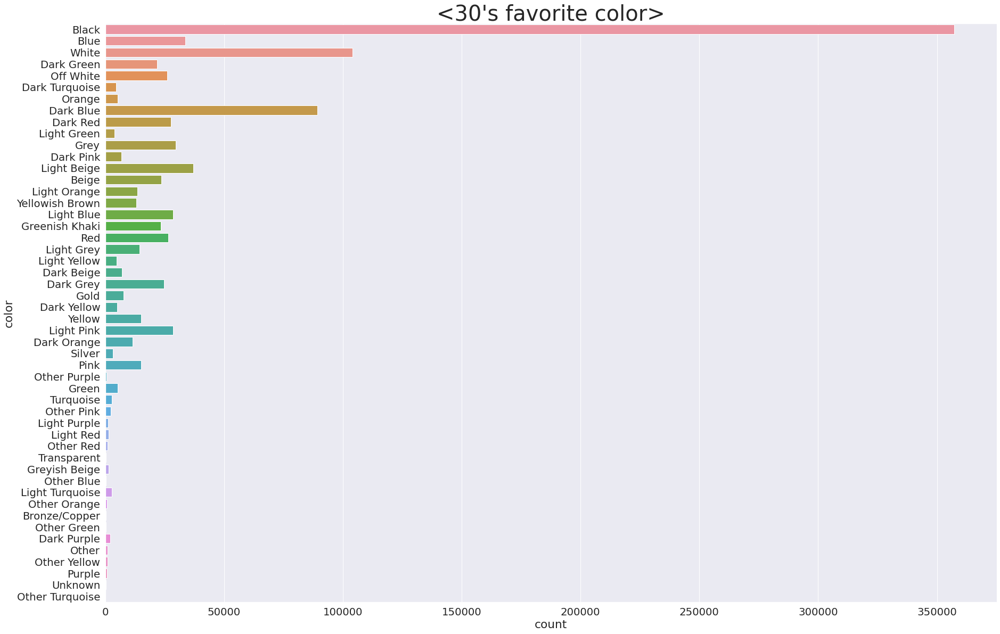

In [ ]:
sns.set(font_scale=1.8)
plt.figure(figsize=(30,20))
plt.title("<30's favorite color>", fontsize=40)
sns.countplot(data=df_thirty_color, y=df_thirty_color)
plt.ylabel('color')

- 30대가 가장 선호하는 색상 : Black, White, Dark Blue

#### 2-4.40대

In [ ]:
df_forty_product = data[data['age_segment'] == 40.0]['garment_group_name']
df_forty_color = data[data['age_segment'] == 40.0]['colour_group_name']

Text(0, 0.5, 'item')

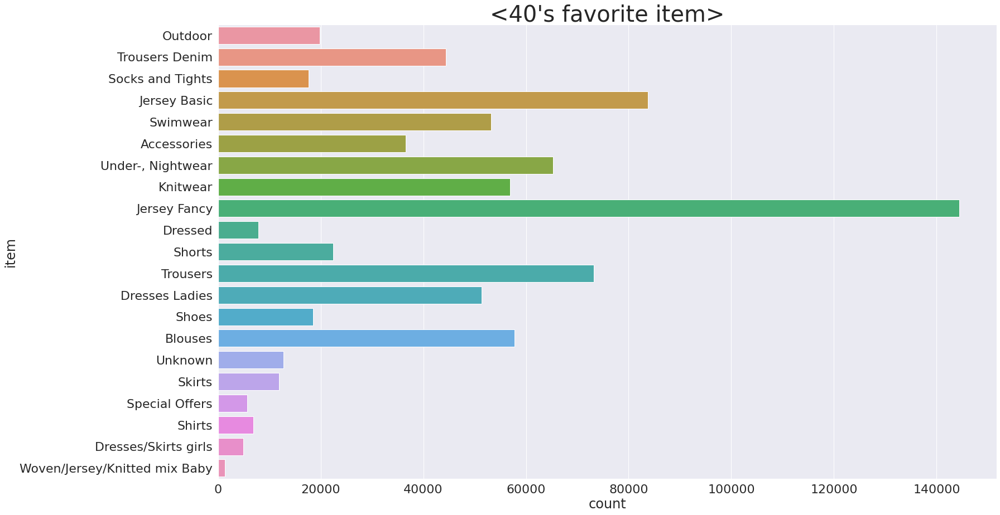

In [ ]:
sns.set(font_scale=2)
plt.figure(figsize=(25,15))
plt.title("<40's favorite item>", fontsize=40)
sns.countplot(data=df_forty_product, y=df_forty_product)
plt.ylabel('item')

- 40대가 가장 선호하는 아이템 : Jersey Fancy, Jersey Basic, Trousers

Text(0, 0.5, 'color')

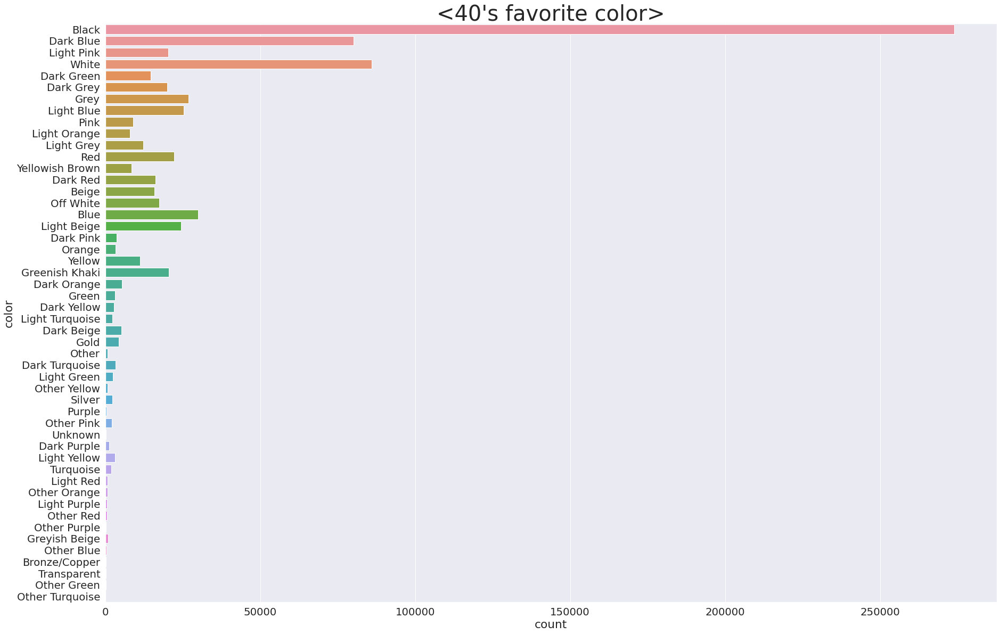

In [ ]:
sns.set(font_scale=1.8)
plt.figure(figsize=(30,20))
plt.title("<40's favorite color>", fontsize=40)
sns.countplot(data=df_forty_color, y=df_forty_color)
plt.ylabel('color')

- 40대가 가장 선호하는 색상 : Black, White, Dark Blue

#### 2-5.50대

In [ ]:
df_fifty_product = data[data['age_segment'] == 50.0]['garment_group_name']
df_fifty_color=data[data['age_segment'] == 50.0]['colour_group_name']

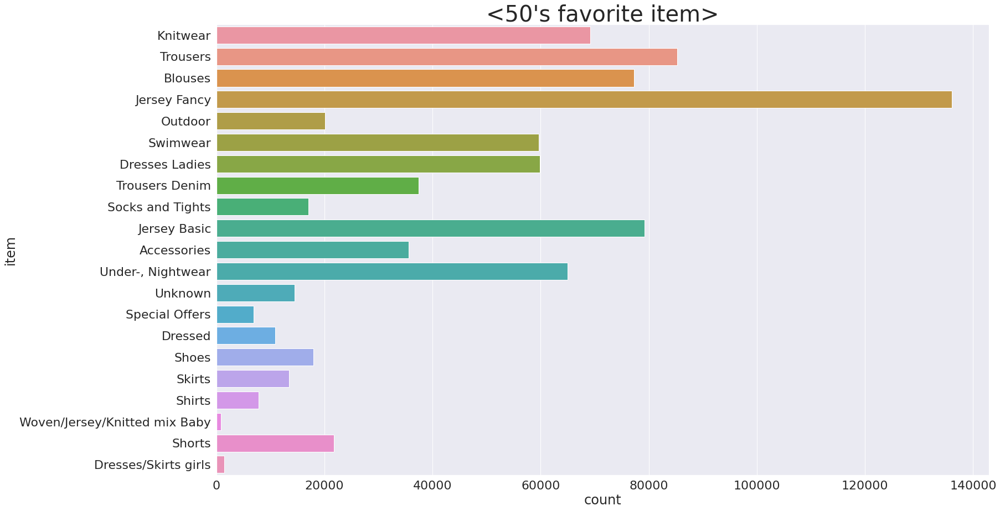

In [ ]:
sns.set(font_scale=2)
plt.figure(figsize=(25,15))
plt.title("<50's favorite item>", fontsize=40)
sns.countplot(data=df_fifty_product, y=df_fifty_product)
plt.ylabel('item')
sns.set(font_scale=3)

- 50대가 가장 선호하는 아이템 : Jersey Fancy, Trousers, Jersey Basic, Blouses

Text(0, 0.5, 'color')

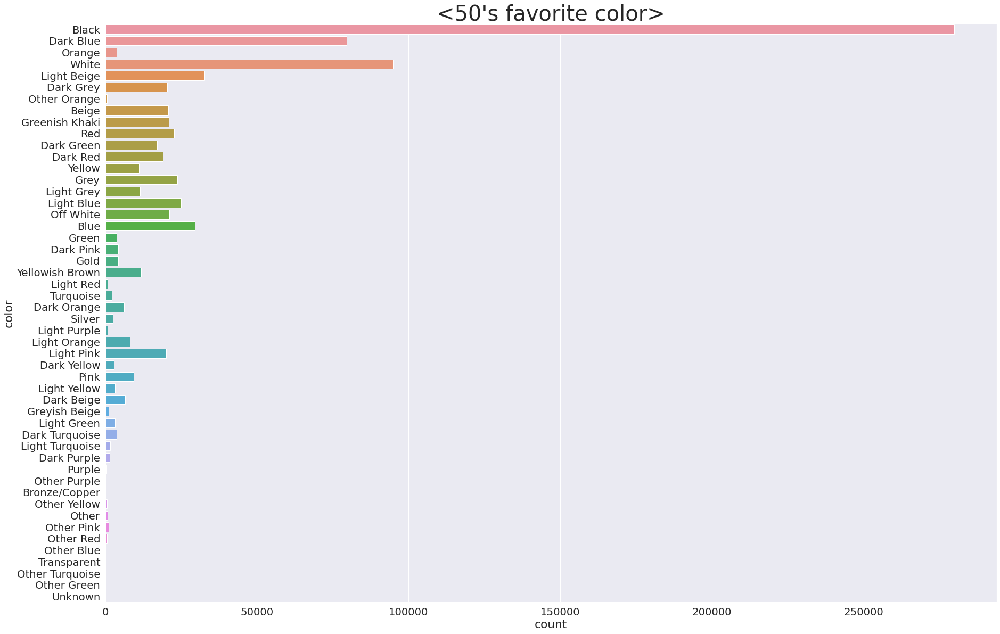

In [ ]:
sns.set(font_scale=1.8)
plt.figure(figsize=(30,20))
plt.title("<50's favorite color>", fontsize=40)
sns.countplot(data=df_fifty_color, y=df_fifty_color)
plt.ylabel('color')

- 50대가 가장 선호하는 색상 : Black, White, Dark Blue

#### 2-6.60대

In [ ]:
df_sixty_product = data[data['age_segment']==60.0]['garment_group_name']
df_sixty_color = data[data['age_segment']==60.0]['colour_group_name']

Text(0, 0.5, 'item')

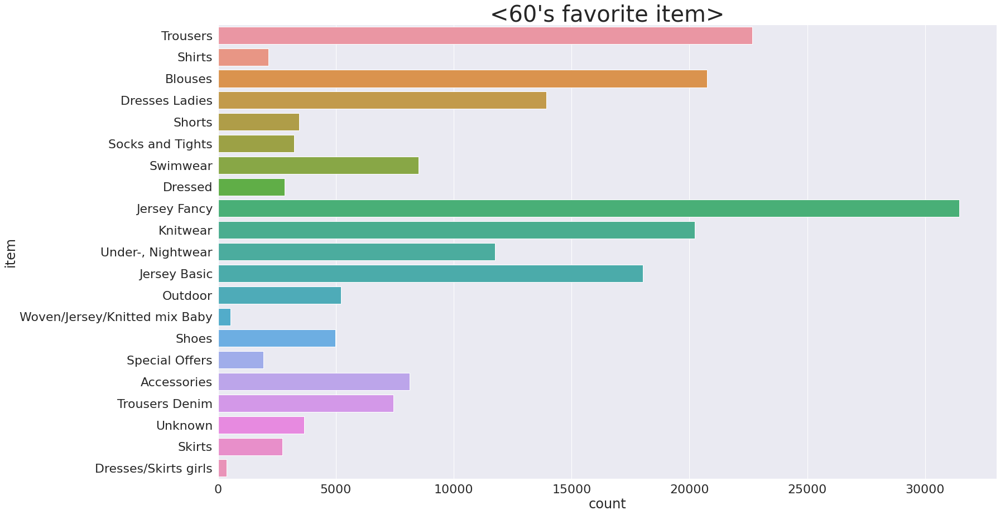

In [ ]:
sns.set(font_scale=2)
plt.figure(figsize=(25,15))
plt.title("<60's favorite item>", fontsize=40)
sns.countplot(data=df_sixty_product, y=df_sixty_product)
plt.ylabel('item')

- 60대가 가장 선호하는 아이템 : Jersey Fancy, Trousers, Blouses, Knitwear

Text(0, 0.5, 'color')

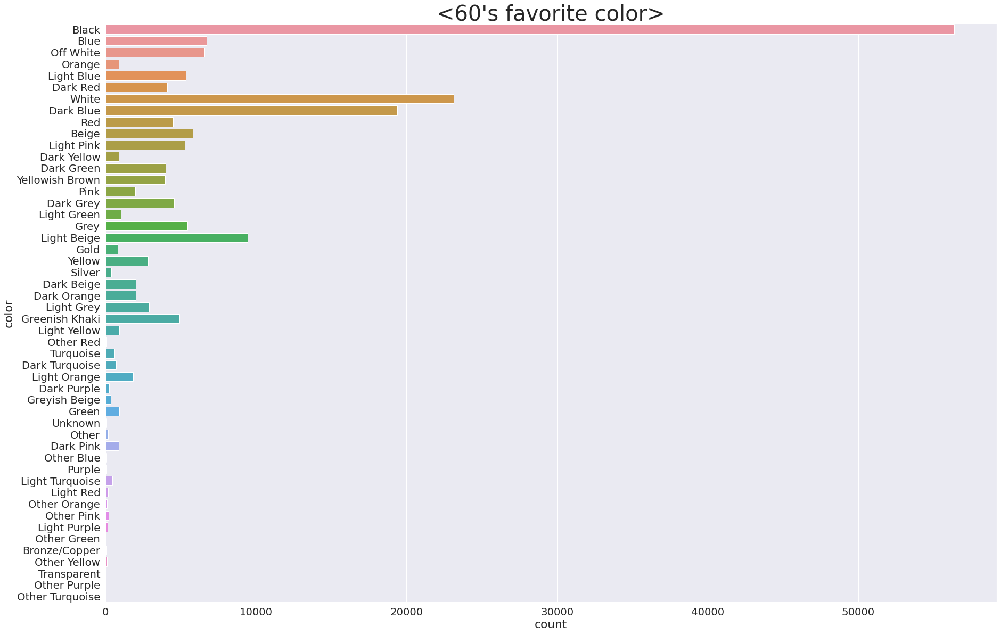

In [ ]:
sns.set(font_scale=1.8)
plt.figure(figsize=(30,20))
plt.title("<60's favorite color>", fontsize=40)
sns.countplot(data=df_sixty_color, y=df_sixty_color)
plt.ylabel('color')

- 60대가 가장 선호하는 색상 : Black, White, Dark Blue

- **연령별 선호하는 색상은 비슷하게 나타남**

### 📌Color
- 같은 색상에도 명도나 채도에 따라서 사람들의 색에 대한 선호도가 다르기 때문에 색을 세분화해서 시각화를 해봄  
(예를 들어 버건디는 빨강에 속한다고 볼 수도 있지만 빨강이라고 보기는 어렵다.)

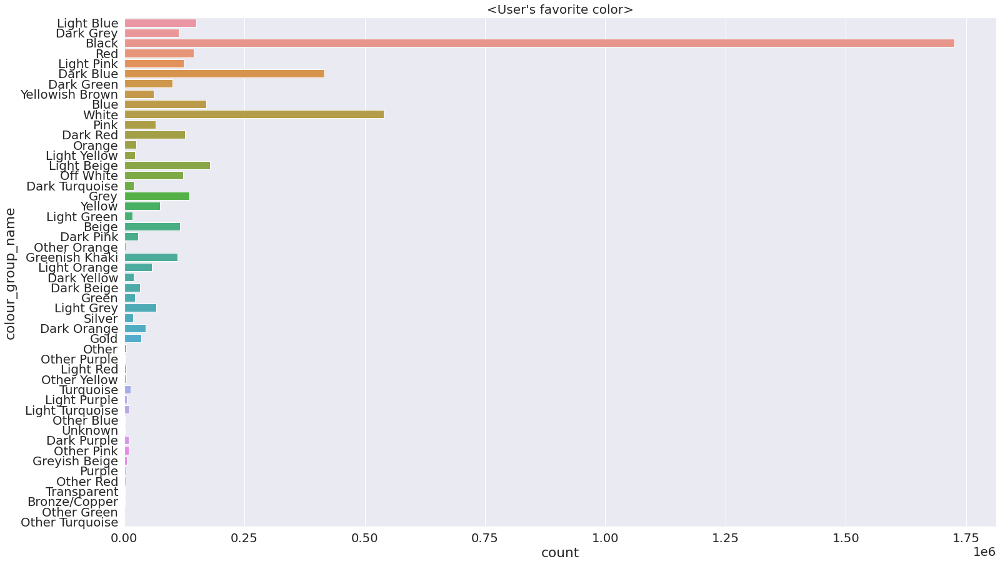

In [ ]:
plt.figure(figsize=(25,15))

plt.title("<User's favorite color>", fontsize=20)
sns.countplot(data=data, y='colour_group_name')

### 1.봄 컬러  
#### 1-1.컬러비교

In [ ]:
spring_color=data[(data['season']=='Spring') & (data['colour_group_name'] !='Black')][['colour_group_name','season']]

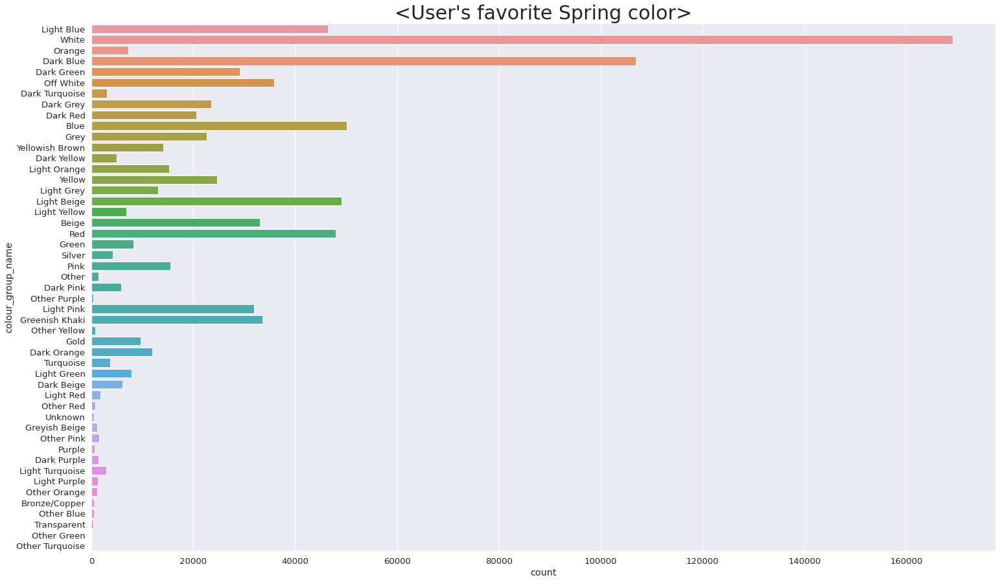

In [ ]:
# 봄 색상
sns.set(font_scale=1.2)
plt.figure(figsize=(25,15))

plt.title("<User's favorite Spring color>", fontsize=30)

sns.countplot(data=spring_color, y='colour_group_name')

- 봄 색상 : Light Blue, Blue, Light Beige, Beige, red 등 밝은 색상의 비율이 비교적 높아짐

In [ ]:
def season_color(season_color, season_name): #계절마다 선호하는 컬러 뽑기 위한 함수 
    season_color = data[(data['season'] == season_name)][['colour_group_name','season']]
    temp = season_color.groupby(by = ['colour_group_name']).agg({'colour_group_name':'count'})
    temp.columns = ['count']
    temp = temp.reset_index()
    temp = temp.sort_values(by = ['count'], ascending=False)
    temp = temp.head(6)
    
    color_temp = temp.copy()
    color_temp['final_color'] = None
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("dark blue"), "dark blue", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("light beige"), "light beige", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("white"), "white", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("black"), "black", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("blue"), "blue", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("red"), "red", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("light blue"), "light blue", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("off white"), "off white", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("greenish khaki"), "khaki", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("beige"), "beige", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("light pink"), "light pink", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("dark red"), "dark red", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("dark green"), "dark green", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("dark pink"), "dark pink", color_temp['final_color'])
    color_temp['final_color'] = np.where(color_temp['colour_group_name'].str.lower().str.contains("grey"), "grey", color_temp['final_color'])

    color_temp = color_temp[color_temp['final_color'].isna() == False]
    

    colours = {
    "black": "#000000",
    "blue": "#0000FF",
    "white": "#FFFFFF",
    "dark blue": "#00008B",
    "light beige": "#EBD3B0",
    "red": "#FF0000",
    "light blue": "#87CEFA",
    "off white": "#F5F5F5",
    "khaki": "#8F784B",
    "beige": "#F5F5DC",
    "light pink": "#FFB6C1",
    "grey": '#808080',
    "dark red": '#8B0000'
    }

    plotly_plt = px.bar(color_temp, x="colour_group_name", y="count", 
             title = season_name+' '+"color sales top6",
             color = "final_color",
             text = "count",
             width = 900, height=500,
             color_discrete_map=colours,
            )
    
    plotly_plt.show()

#### 1-2.선호하는 봄 컬러 Top 6

In [ ]:
season_color(spring_color, 'Spring')

- 주요 컬러(Black, White, Dark Blue)를 제외하면 비교적 밝은 색상이 선호됨 

### 2.여름 컬러
#### 2-1.컬러 비교 

In [ ]:
summer_color=data[(data['season']=='Summer') & (data['colour_group_name'] !='Black')][['colour_group_name','season']]

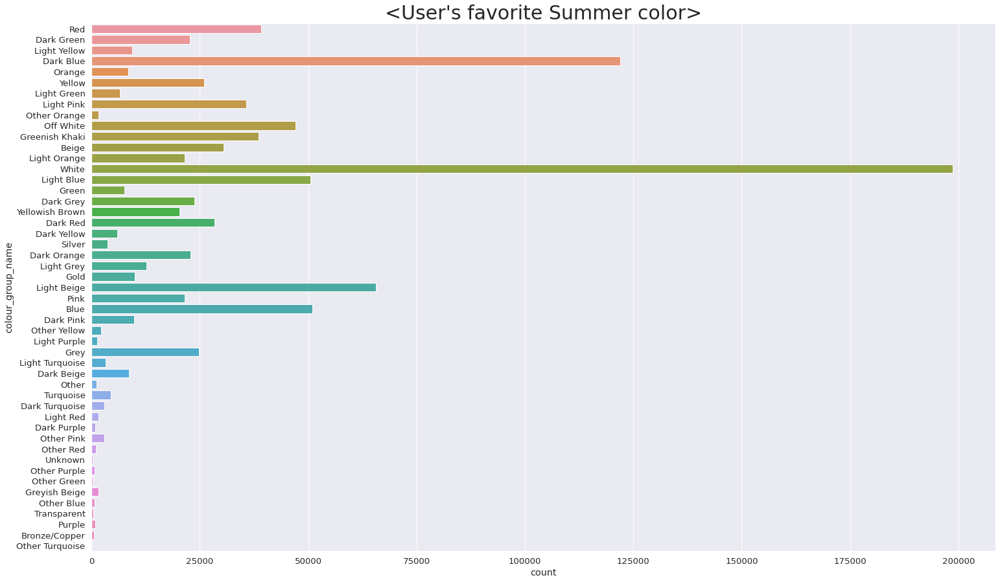

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(25,15))

plt.title("<User's favorite Summer color>", fontsize=30)

sns.countplot(data=summer_color, y='colour_group_name')

- 봄의 선호 색상과 비슷한 선호도를 가짐

#### 2-2. 선호하는 여름 컬러 Top 6

In [ ]:
season_color(summer_color, 'Summer')

- 주요 컬러(Black, White, Dark Blue)를 제외하면 시원한 색상의 선호도가 높아짐

### 3.가을 컬러 
#### 3-1.컬러 비교

In [ ]:
fall_color=data[(data['season']=='Fall') & (data['colour_group_name'] !='Black')][['colour_group_name','season']]

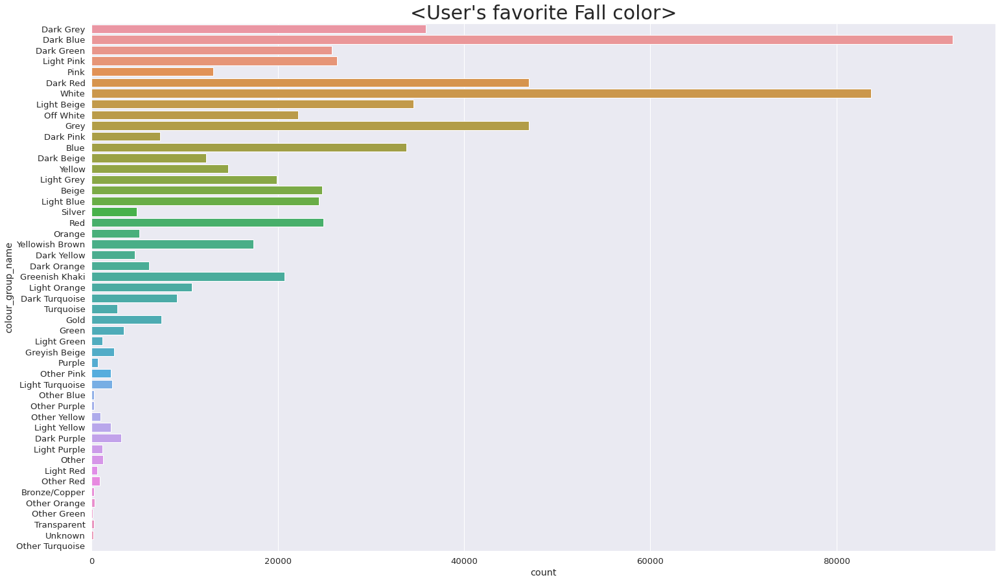

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(25,15))

plt.title("<User's favorite Fall color>", fontsize=30)

sns.countplot(data=fall_color, y='colour_group_name')

- 봄과 여름에 비해서 Grey 계열의 살짝 어두움 색상이 비교적 높은 선호도를 가짐

#### 3-2.선호하는 가을 컬러 Top 6

In [ ]:
season_color(fall_color, 'Fall')

- 주요 컬러(Black, White, Dark Blue)를 제외하면 비교적 어두운 색상이 선호됨

### 4.겨울컬러
#### 4-1.컬러 비교

In [ ]:
winter_color=data[(data['season']=='Winter') & (data['colour_group_name'] != 'Black')][['colour_group_name','season']]

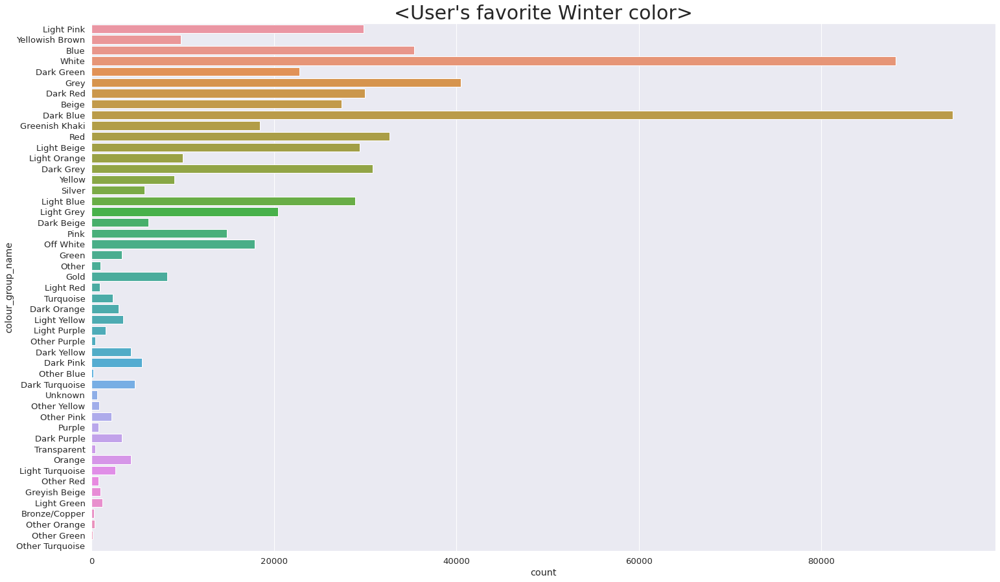

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(25,15))

plt.title("<User's favorite Winter color>", fontsize=30)

sns.countplot(data=winter_color, y='colour_group_name')

- 겨울은 비교적 어두운 색상이 선호됨

#### 4-2.선호하는 겨울 컬러 Top 6

In [ ]:
season_color(winter_color, 'Winter')

- 주요 컬러(Black, White, Dark Blue)를 제외하면 비교적 어두운 색상이 선호됨
- 겨울은 크리스마스가 있어 Red 계열의 선호도가 높아졌다고 예상됨

---

- 2018년의 H&M F/W시즌의 컬러의 컨셉
  - 파우더 핑크, 더스티 로즈, 라일락, 연보라, 버건디, 카멜, 오프화이트
- 2019년의 H&M S/S 시즌의 컬러 컨셉
  - 블랙, 골드 및 실버와 함께 라벤더, 샌드, 아쿠아 블루, 페트롤 블루 및 코랄 핑크
- 판매된 품목의 컬러를 봤을 때 시즌 컬러 컨셉은 소비자에게 큰 영향을 미친 것은 아닌 것 같다고 판단됨

---

### 📌sales_channel_id
#### 1.판매 경로 비교(온/오프라인) 

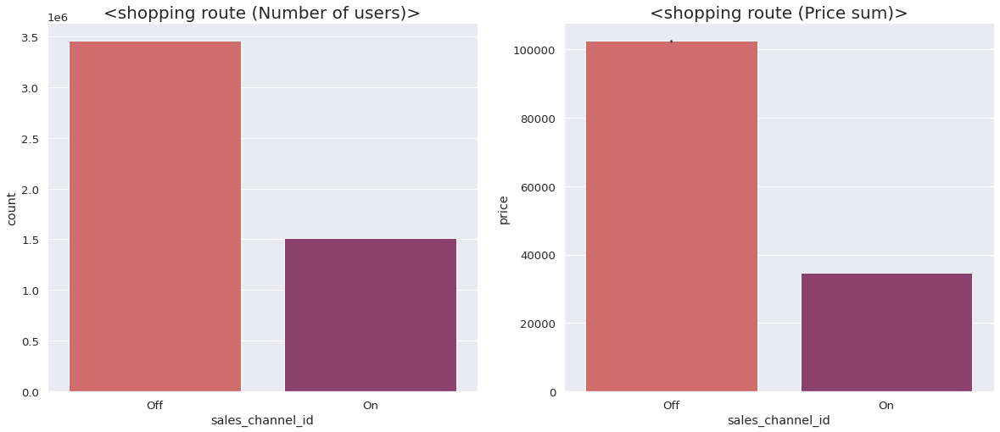

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)
plt.title("<shopping route (Number of users)>", fontsize=20)
sns.countplot(data=data, x='sales_channel_id', palette='flare')

plt.subplot(1,2,2)
plt.title("<shopping route (Price sum)>", fontsize=20)
sns.barplot(data=data, x='sales_channel_id', y='price', estimator=np.sum, palette='flare')

- 오프라인으로 구매하는 고객이 온라인으로 구매하는 고객보다 더 높은 비율을 차지함

In [ ]:
data.groupby('sales_channel_id')['price'].sum()

sales_channel_id
Off    102446.906458
On      34641.418220
Name: price, dtype: float64

In [ ]:
print('전체 중 온라인 판매 수량 비중 : {:.2f}%, 온라인 판매 수량 : {:3,d}'
      .format(len(data[data['sales_channel_id'] == 'On']) / len(data) *100, len(data[data['sales_channel_id'] == 'On'])))
print('전체 중 오프라인 판매 비중 : {:.2f}%, 오프라인 판매 수량 : {:3,d}'
      .format(len(data[data['sales_channel_id'] == 'Off']) / len(data) *100, len(data[data['sales_channel_id'] == 'Off'])))

전체 중 온라인 판매 수량 비중 : 30.45%, 온라인 판매 수량 : 1,513,825
전체 중 오프라인 판매 비중 : 69.55%, 오프라인 판매 수량 : 3,457,953


In [ ]:
print('전체 중 온라인 판매 수량 비중 : {:.2f}%, 온라인 판매 수량 : {:3,d}'
      .format(len(data[data['sales_channel_id'] == 'On']) / len(data) *100, len(data[data['sales_channel_id'] == 'On'])))
print('전체 중 오프라인 판매 비중 : {:.2f}%, 오프라인 판매 수량 : {:3,d}'
      .format(len(data[data['sales_channel_id'] == 'Off']) / len(data) *100, len(data[data['sales_channel_id'] == 'Off'])))

전체 중 온라인 판매 수량 비중 : 30.45%, 온라인 판매 수량 : 1,513,825
전체 중 오프라인 판매 비중 : 69.55%, 오프라인 판매 수량 : 3,457,953


- 온라인으로 샀을 때의 판매 금액 비중이 줄어듦
- 온라인에서 할인으로 팔았을 가능성이 있음
- 온라인으로 구매한 고객들이 비교적 싼 제품을 구매했을 가능성이 있음

#### 2.판매 경로별 index_group 총 판매 금액 비교

In [ ]:
data.groupby(['sales_channel_id', 'index_group_name'])['price'].sum()

sales_channel_id  index_group_name
Off               Baby/Children        3059.957898
                  Divided             23503.213678
                  Ladieswear          67893.010102
                  Menswear             4376.498661
                  Sport                3614.226119
On                Baby/Children        1660.215186
                  Divided              6102.248390
                  Ladieswear          22250.464746
                  Menswear             3097.951237
                  Sport                1530.538661
Name: price, dtype: float64

#### 3. 연령별 판매경로 금액 비교

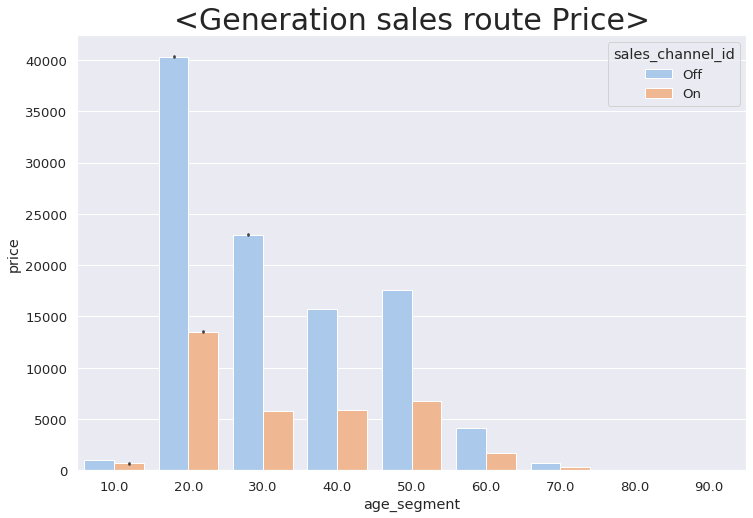

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(12,8))

plt.title('<Generation sales route Total price>', fontsize=30)

plt.xlabel('Age segment')
plt.ylabel('Total Price sum')
sns.barplot(data=data, x='age_segment', y='price', estimator=np.sum, hue='sales_channel_id', palette='pastel')

- 전연령에서 오프라인을 이용한 구매가 온라인보다 훨씬 높음
- 10대는 온라인과 오프라인의 구매 금액 비율이 비슷함

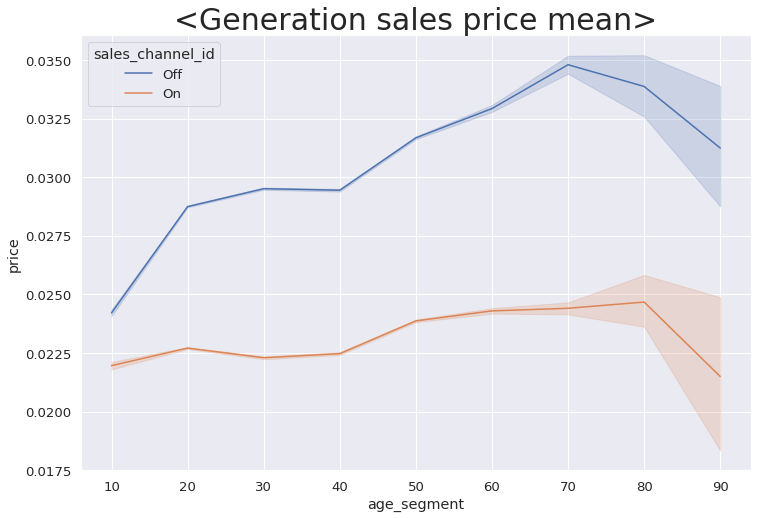

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(12,8))

plt.title('<Generation sales mean>', fontsize=30)

sns.lineplot(data=data, x='age_segment', y='price', hue='sales_channel_id', color='red')

- 오프라인의 아이템 구매 단가가 온라인보다 더 높음  
  - 온라인에서 할인으로 팔았을 가능성이 있음
  - 온라인으로 구매한 고객들이 비교적 싼 제품을 구매했을 가능성이 있음

#### 4. 연령별 온/오프라인 구매 수량 비교  

In [ ]:
data_online = data[data['sales_channel_id'] == 'On']
data_offline = data[data['sales_channel_id'] == 'Off']

In [ ]:
pvt_online_depart_size = pd.pivot_table(data=data_online, index='department_name', columns='age_segment', values='customer_id', aggfunc='size')
pvt_online_depart_size.head(2)

age_segment,10.0,20.0,30.0,40.0,50.0,60.0,70.0,80.0,90.0
department_name,,,,,,,,,
AK Bottoms,1.0,17.0,4.0,2.0,3.0,NaN,2.0,NaN,NaN
AK Dresses & Outdoor,NaN,11.0,4.0,5.0,7.0,NaN,2.0,NaN,NaN


In [ ]:
pvt_offline_depart_size = pd.pivot_table(data=data_offline, index='department_name', columns='age_segment', values='customer_id', aggfunc='size')
pvt_offline_depart_size.head(2)

age_segment,10.0,20.0,30.0,40.0,50.0,60.0,70.0,80.0,90.0
department_name,,,,,,,,,
AK Bottoms,12.0,627.0,249.0,180.0,215.0,47.0,9.0,1.0,NaN
AK Dresses & Outdoor,12.0,588.0,274.0,157.0,155.0,50.0,7.0,NaN,NaN


##### 4-1.10대

In [ ]:
print('<10대 온라인 구매 아이템 Top 5>')
pvt_online_depart_size[10.0].sort_values(ascending=False).head(5)

<10대 온라인 구매 아이템 Top 5>


department_name
Basic 1                2125.0
Swimwear               2113.0
Tops Fancy Jersey      1724.0
Expressive Lingerie    1395.0
Blouse                 1185.0
Name: 10.0, dtype: float64

In [ ]:
print('<10대 오프라인 구매 아이템 Top 5>')
pvt_offline_depart_size[10.0].sort_values(ascending=False).head(5)

<10대 오프라인 구매 아이템 Top 5>


department_name
Swimwear             6880.0
Tops Fancy Jersey    2435.0
Basic 1              2348.0
Trousers             2219.0
Dresses              2156.0
Name: 10.0, dtype: float64

##### 4-2.20대

In [ ]:
print('<20대 온라인 구매 아이템 Top 5>')
pvt_online_depart_size[20.0].sort_values(ascending=False).head(5)

<20대 온라인 구매 아이템 Top 5>


department_name
Expressive Lingerie    33030.0
Knitwear               31546.0
Swimwear               31291.0
Jersey Basic           30826.0
Blouse                 30544.0
Name: 20.0, dtype: float64

In [ ]:
print('<20대 오프라인 구매 아이템 Top 5>')
pvt_offline_depart_size[20.0].sort_values(ascending=False).head(5)

<20대 오프라인 구매 아이템 Top 5>


department_name
Swimwear    171562.0
Trouser      70902.0
Blouse       69582.0
Jersey       60315.0
Knitwear     56123.0
Name: 20.0, dtype: float64

##### 4-3.30대

In [ ]:
print('<30대 온라인 구매 아이템 Top 5>')
pvt_online_depart_size[30.0].sort_values(ascending=False).head(5)

<30대 온라인 구매 아이템 Top 5>


department_name
Jersey Basic           17162.0
Knitwear               13318.0
Expressive Lingerie    13203.0
Blouse                 13113.0
Trouser                12241.0
Name: 30.0, dtype: float64

In [ ]:
print('<30대 오프라인 구매 아이템 Top 5>')
pvt_offline_depart_size[30.0].sort_values(ascending=False).head(5)

<30대 오프라인 구매 아이템 Top 5>


department_name
Swimwear        67613.0
Jersey          47830.0
Trouser         39739.0
Blouse          37430.0
Jersey Basic    36147.0
Name: 30.0, dtype: float64

##### 4-4. 40대

In [ ]:
print('<40대 온라인 구매 아이템 Top 5>')
pvt_online_depart_size[40.0].sort_values(ascending=False).head(5)

<40대 온라인 구매 아이템 Top 5>


department_name
Blouse          14609.0
Jersey Basic    14097.0
Knitwear        12724.0
Trouser         12615.0
Jersey          10344.0
Name: 40.0, dtype: float64

In [ ]:
print('<40대 오프라인 구매 아이템 Top 5>')
pvt_offline_depart_size[40.0].sort_values(ascending=False).head(5)

<40대 오프라인 구매 아이템 Top 5>


department_name
Swimwear        40980.0
Trouser         29840.0
Jersey          27034.0
Blouse          24589.0
Jersey Basic    22477.0
Name: 40.0, dtype: float64

##### 4-5.50대

In [ ]:
print('<50대 온라인 구매 아이템 Top 5>')
pvt_online_depart_size[20.0].sort_values(ascending=False).head(5)

<50대 온라인 구매 아이템 Top 5>


department_name
Expressive Lingerie    33030.0
Knitwear               31546.0
Swimwear               31291.0
Jersey Basic           30826.0
Blouse                 30544.0
Name: 20.0, dtype: float64

In [ ]:
print('<50대 오프라인 구매 아이템 Top 5>')
pvt_offline_depart_size[20.0].sort_values(ascending=False).head(5)

<50대 오프라인 구매 아이템 Top 5>


department_name
Swimwear    171562.0
Trouser      70902.0
Blouse       69582.0
Jersey       60315.0
Knitwear     56123.0
Name: 20.0, dtype: float64

##### 4-6. 60대

In [ ]:
print('<60대 온라인 구매 아이템 Top 5>')
pvt_online_depart_size[60.0].sort_values(ascending=False).head(5)

<60대 온라인 구매 아이템 Top 5>


department_name
Blouse          6358.0
Knitwear        5950.0
Trouser         5886.0
Jersey Basic    4904.0
Jersey fancy    4469.0
Name: 60.0, dtype: float64

In [ ]:
print('<60대 오프라인 구매 아이템 Top 5>')
pvt_offline_depart_size[60.0].sort_values(ascending=False).head(5)

<60대 오프라인 구매 아이템 Top 5>


department_name
Trouser     10620.0
Knitwear     8797.0
Blouse       8476.0
Jersey       7242.0
Swimwear     6740.0
Name: 60.0, dtype: float64

- **온라인을 이용하는 고객은 오프라인에 비해 수영복을 비교적 구매하지 않음**
- **오프라인을 이용하는 고객은 연령별로 선호하는 아이템의 종류가 서로 다름**


### 📌Department_name 

- H&M에서 의류를 분류하는 최하위 카테고리
- 240가지의 분류를 가짐

In [ ]:
data['department_name'].nunique()

240

In [ ]:
df_department_top10 = data.groupby(['department_name']).size().sort_values(ascending=False).head(10)
df_department_top10

department_name
Swimwear               406927
Trouser                271776
Blouse                 263466
Knitwear               235506
Jersey                 230410
Jersey Basic           229313
Expressive Lingerie    182495
Jersey fancy           180162
Basic 1                161952
Dress                  160358
dtype: int64

In [ ]:
pvt_department_size = pd.pivot_table(data=data, index='month', columns='department_name', values='customer_id', aggfunc='size')
pvt_department_size

department_name,AK Bottoms,AK Dresses & Outdoor,AK Other,AK Tops Jersey & Woven,AK Tops Knitwear,Accessories,Accessories Boys,Asia Assortment,Baby Boy Jersey Fancy,Baby Boy Knitwear,...,Young Girl Jersey Basic,Young Girl Jersey Fancy,Young Girl Knitwear,Young Girl Outdoor,Young Girl S&T,Young Girl Shoes,Young Girl Swimwear,Young Girl Trouser,Young Girl UW/NW,Young boy Swimwear
month,,,,,,,,,,,,,,,,,,,,,
1,94.0,73.0,9.0,33.0,33.0,845.0,9.0,337.0,402.0,143.0,...,971.0,2208.0,560.0,271.0,154.0,106.0,127.0,484.0,775.0,35.0
2,164.0,125.0,4.0,32.0,51.0,439.0,12.0,277.0,402.0,80.0,...,1007.0,2136.0,350.0,165.0,149.0,78.0,155.0,427.0,584.0,62.0
3,98.0,133.0,5.0,10.0,17.0,278.0,13.0,208.0,310.0,32.0,...,727.0,1345.0,160.0,117.0,63.0,80.0,204.0,352.0,446.0,41.0
4,253.0,125.0,NaN,47.0,14.0,237.0,5.0,112.0,318.0,16.0,...,748.0,1341.0,99.0,50.0,75.0,82.0,289.0,760.0,413.0,116.0
5,199.0,188.0,1.0,49.0,13.0,234.0,1.0,79.0,269.0,12.0,...,573.0,1007.0,100.0,40.0,47.0,74.0,240.0,352.0,334.0,73.0
6,189.0,169.0,6.0,43.0,12.0,342.0,2.0,58.0,267.0,3.0,...,728.0,1078.0,44.0,31.0,55.0,105.0,320.0,529.0,399.0,160.0
7,141.0,162.0,NaN,55.0,59.0,388.0,5.0,48.0,278.0,6.0,...,547.0,956.0,53.0,51.0,53.0,79.0,194.0,366.0,361.0,114.0
8,73.0,135.0,1.0,45.0,42.0,254.0,NaN,40.0,237.0,31.0,...,416.0,737.0,157.0,74.0,82.0,81.0,49.0,179.0,253.0,47.0
9,32.0,69.0,2.0,17.0,7.0,286.0,NaN,34.0,213.0,64.0,...,493.0,858.0,309.0,249.0,81.0,76.0,8.0,197.0,288.0,4.0


In [ ]:
department_list_temp = []

for i in df_department_top10.index:
    department_list_temp.append(i)

In [ ]:
department_size_top10 = pvt_department_size[department_list_temp]
department_size_top10

department_name,Swimwear,Trouser,Blouse,Knitwear,Jersey,Jersey Basic,Expressive Lingerie,Jersey fancy,Basic 1,Dress
month,,,,,,,,,,
1,23755.0,19602.0,14193.0,27999.0,14286.0,14223.0,18903.0,10868.0,13068.0,5376.0
2,21450.0,20310.0,15257.0,16853.0,15360.0,15809.0,14133.0,11111.0,11316.0,6873.0
3,33060.0,24431.0,22335.0,13746.0,19991.0,17640.0,13354.0,13970.0,10872.0,11065.0
4,50989.0,25355.0,24847.0,6850.0,25855.0,24706.0,12234.0,19368.0,12835.0,19185.0
5,64558.0,23680.0,26718.0,6773.0,25877.0,23164.0,17182.0,20472.0,11935.0,22093.0
6,84646.0,26156.0,34151.0,5259.0,28978.0,30155.0,17699.0,26835.0,16935.0,27752.0
7,74279.0,24129.0,35673.0,5970.0,24888.0,27472.0,16875.0,23168.0,22317.0,23521.0
8,26986.0,19918.0,21319.0,13212.0,17118.0,19659.0,15032.0,15193.0,14045.0,13171.0
9,6283.0,22675.0,18679.0,37197.0,13924.0,16612.0,11935.0,10225.0,15506.0,10290.0


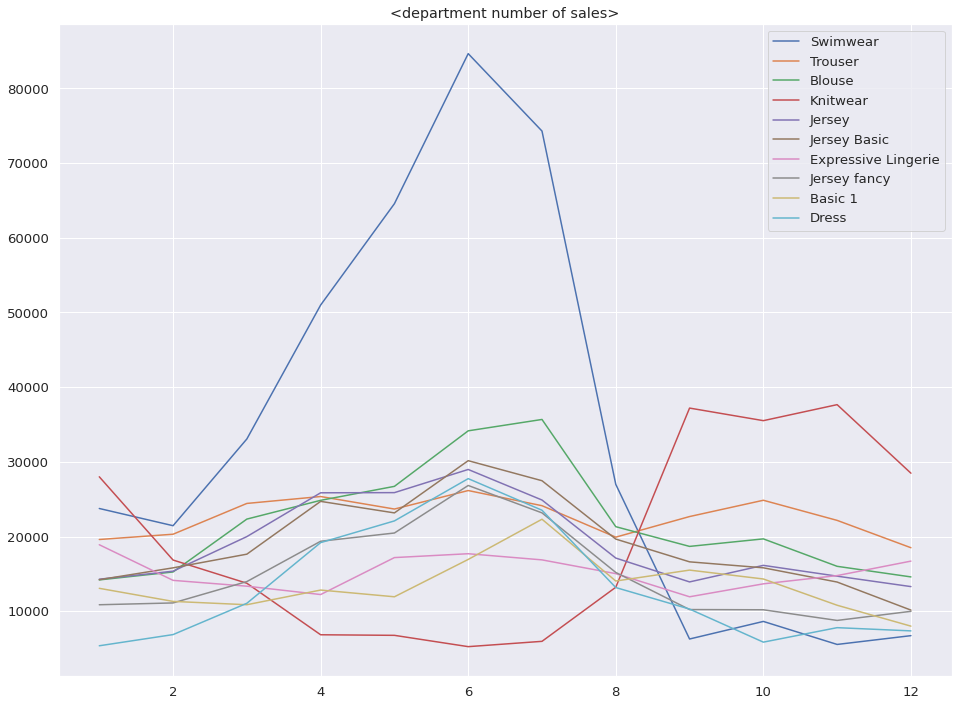

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(16, 12))

plt.title('<department number of sales>')
plt.plot(department_size_top10)
plt.legend(labels=department_list_temp)

In [ ]:
print('전체 중 "Swimwear"의 판매 수량 비율 : {:.2f}%'.format(len(data[data['department_name'] == 'Swimwear']) / len(data) *100))

전체 중 "Swimwear"의 판매 수량 비율 : 8.18%


### 📌 Garment Group Name 

- H&M에서 의류를 분류한 중위 카테고리
- 총 21가지의 아이템을 분류함

In [ ]:
data['garment_group_name'].nunique()

21

#### 1.garment 판매 수량 

In [ ]:
data.groupby('garment_group_name')['customer_id'].count().sort_values(ascending=False)

garment_group_name
Jersey Fancy                     820587
Jersey Basic                     488168
Trousers                         462085
Under-, Nightwear                420741
Swimwear                         416133
Blouses                          403027
Knitwear                         371139
Dresses Ladies                   336545
Accessories                      253998
Trousers Denim                   207052
Shorts                           127817
Shoes                            123168
Outdoor                          112312
Socks and Tights                 108077
Skirts                            89777
Unknown                           75283
Dressed                           57501
Special Offers                    40247
Shirts                            35036
Dresses/Skirts girls              11976
Woven/Jersey/Knitted mix Baby     11109
Name: customer_id, dtype: int64

In [ ]:
pvt_garment_price_season = pd.pivot_table(data=data, index='season', columns='garment_group_name', values='price', aggfunc='sum')
pvt_garment_price_season

garment_group_name,Accessories,Blouses,Dressed,Dresses Ladies,Dresses/Skirts girls,Jersey Basic,Jersey Fancy,Knitwear,Outdoor,Shirts,...,Shorts,Skirts,Socks and Tights,Special Offers,Swimwear,Trousers,Trousers Denim,"Under-, Nightwear",Unknown,Woven/Jersey/Knitted mix Baby
season,,,,,,,,,,,,,,,,,,,,,
Fall,1145.480475,2345.233864,1093.823983,2171.899542,71.963441,1881.307492,4377.956136,5900.366119,3520.966780,266.344390,...,113.260593,765.769847,451.674949,535.273661,337.538932,4100.048864,2180.103729,2135.074373,1117.597915,79.591559
Spring,965.280271,3605.167508,882.976136,4019.017627,57.935780,1845.318881,5476.885288,1214.213051,1313.546119,237.801186,...,1034.603932,834.644763,268.220864,377.809492,3639.860085,4590.518695,2098.977983,2063.393339,840.011458,41.822102
Summer,939.629492,3317.095441,554.064983,4391.201119,42.298966,2094.130881,4931.563559,1143.571763,857.948915,239.482508,...,1822.268780,968.613051,188.682898,172.226763,4054.576763,3806.889068,1815.737085,2370.887864,575.849305,35.588644
Winter,1004.221254,1926.636576,763.841203,1762.722136,83.940525,1490.711068,4045.092102,3463.070373,1990.515576,270.589797,...,112.324390,551.610966,406.596746,313.545763,1217.699136,3423.731932,1928.069356,2177.308712,972.377220,76.804525


In [ ]:
pvt_garment_size = pd.pivot_table(data=data, index='month', columns='garment_group_name', values='customer_id', aggfunc='size')
pvt_garment_size

garment_group_name,Accessories,Blouses,Dressed,Dresses Ladies,Dresses/Skirts girls,Jersey Basic,Jersey Fancy,Knitwear,Outdoor,Shirts,...,Shorts,Skirts,Socks and Tights,Special Offers,Swimwear,Trousers,Trousers Denim,"Under-, Nightwear",Unknown,Woven/Jersey/Knitted mix Baby
month,,,,,,,,,,,,,,,,,,,,,
1,21390,22168,4538,13146,1090,33662,62774,43884,11770,1901,...,1733,4331,8834,5070,24569,35655,19592,40860,8805,1185
2,20539,24632,5035,15251,1250,34314,59210,25950,10212,2254,...,2103,5546,8645,2481,22210,36091,19154,32250,7207,1266
3,18663,35537,5831,22479,808,34647,66943,20776,9746,1988,...,3443,6148,7676,2284,33613,42422,19085,31492,8144,718
4,19111,39188,5255,35384,939,45511,77525,12088,6661,2463,...,13887,7578,7143,4279,51671,43542,16370,30748,5658,752
5,20713,40737,4374,41520,748,42838,77560,11873,5626,3188,...,20347,8289,7267,3591,65890,39089,15669,36544,4128,579
6,21562,51110,2997,59343,865,57058,93295,10435,4290,3611,...,35061,10988,5821,1679,86224,41964,17894,40724,5352,570
7,22623,53264,2830,49331,850,60134,87461,10240,4756,3282,...,32113,9520,5576,1722,75582,39934,17028,40776,5134,662
8,18037,33134,4628,26955,523,40487,62295,20385,6181,2117,...,12109,8302,5630,2769,27606,35107,16067,34800,4206,604
9,18065,26290,7206,18068,408,39667,53041,52116,12925,2124,...,2318,8143,9181,5259,6480,39031,17432,31223,5514,587


In [ ]:
df_garment_top10 = data.groupby(['garment_group_name']).size().sort_values(ascending=False).head(10)
df_garment_top10

garment_group_name
Jersey Fancy         820587
Jersey Basic         488168
Trousers             462085
Under-, Nightwear    420741
Swimwear             416133
Blouses              403027
Knitwear             371139
Dresses Ladies       336545
Accessories          253998
Trousers Denim       207052
dtype: int64

In [ ]:
garment_list_top_temp = []

for i in df_garment_top10.index:
    garment_list_top_temp.append(i)

In [ ]:
garment_size_top10 = pvt_garment_size[garment_list_top_temp]
garment_size_top10

garment_group_name,Jersey Fancy,Jersey Basic,Trousers,"Under-, Nightwear",Swimwear,Blouses,Knitwear,Dresses Ladies,Accessories,Trousers Denim
month,,,,,,,,,,
1,62774,33662,35655,40860,24569,22168,43884,13146,21390,19592
2,59210,34314,36091,32250,22210,24632,25950,15251,20539,19154
3,66943,34647,42422,31492,33613,35537,20776,22479,18663,19085
4,77525,45511,43542,30748,51671,39188,12088,35384,19111,16370
5,77560,42838,39089,36544,65890,40737,11873,41520,20713,15669
6,93295,57058,41964,40724,86224,51110,10435,59343,21562,17894
7,87461,60134,39934,40776,75582,53264,10240,49331,22623,17028
8,62295,40487,35107,34800,27606,33134,20385,26955,18037,16067
9,53041,39667,39031,31223,6480,26290,52116,18068,18065,17432


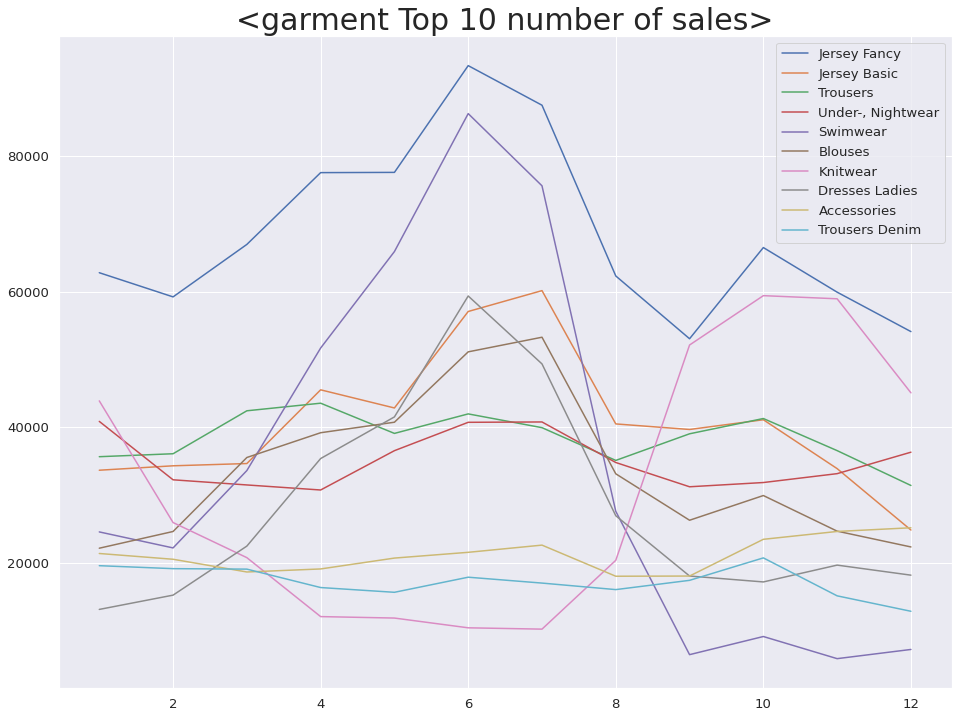

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(16, 12))

plt.title('<garment Top 10 number of sales>', fontsize=30)
plt.plot(garment_size_top10)
plt.legend(labels=garment_list_top_temp)

- Jersey Fancy의 비율이 매우 높음  
(Jersey는 원단에 의한 분류이므로 광범위한 카테고리를 가진 아이템 분류)
- Swimwear는 여름에 비율이 매우 높아졌다가 여름이 지난 후 급격하게 비율이 떨어짐 (5월부터 여름 준비를 하는 것으로 판단됨)
- Kitwear는 겨울에 비율이 매우 높아졌다가 겨울이 지난 후 급격하게 비율이 떨어짐

In [ ]:
df_garment_bottom10 = data.groupby(['garment_group_name']).size().sort_values(ascending=True).head(10)

garment_list_bottom_temp = []

for i in df_garment_bottom10.index:
    garment_list_bottom_temp.append(i)
    
garment_size_bottom10 = pvt_garment_size[garment_list_bottom_temp]
garment_size_bottom10

garment_group_name,Woven/Jersey/Knitted mix Baby,Dresses/Skirts girls,Shirts,Special Offers,Dressed,Unknown,Skirts,Socks and Tights,Outdoor,Shoes
month,,,,,,,,,,
1,1185,1090,1901,5070,4538,8805,4331,8834,11770,8158
2,1266,1250,2254,2481,5035,7207,5546,8645,10212,7152
3,718,808,1988,2284,5831,8144,6148,7676,9746,9550
4,752,939,2463,4279,5255,5658,7578,7143,6661,13136
5,579,748,3188,3591,4374,4128,8289,7267,5626,12802
6,570,865,3611,1679,2997,5352,10988,5821,4290,15819
7,662,850,3282,1722,2830,5134,9520,5576,4756,14071
8,604,523,2117,2769,4628,4206,8302,5630,6181,9507
9,587,408,2124,5259,7206,5514,8143,9181,12925,7401


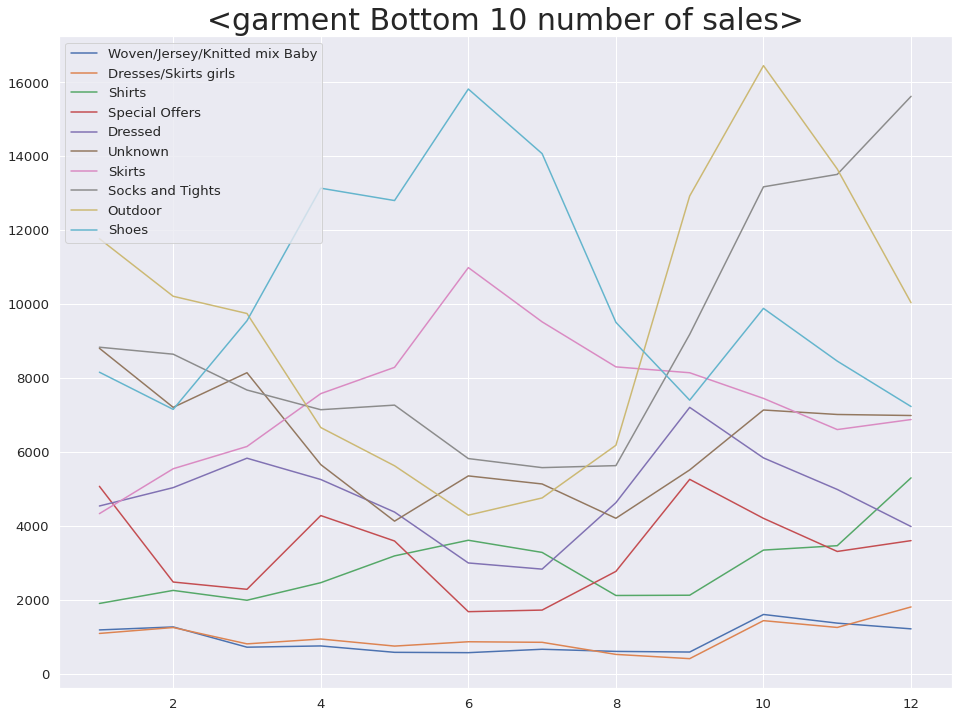

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(16, 12))

plt.title('<garment Bottom 10 number of sales>', fontsize=30)
plt.plot(garment_size_bottom10)
plt.legend(labels=garment_list_bottom_temp)

In [ ]:
print('상위 10개의 판매 수량 : {:3,d}'.format(garment_size_top10.sum().sum()))
print('하위 10개의 판매 수량 : {:3,d}'.format(garment_size_bottom10.sum().sum()))

상위 10개의 판매 수량 : 4,179,475
하위 10개의 판매 수량 : 664,486


In [ ]:
print('전체 중, 상위 10개 아이템이 차지하는 비율 : {:.2f}%'.format(garment_size_top10.sum().sum() / len(data) * 100))
print('전체 중, 하위 10개 아이템이 차지하는 비율 : {:.2f}%'.format(garment_size_bottom10.sum().sum() / len(data) * 100))

전체 중, 상위 10개 아이템이 차지하는 비율 : 84.06%
전체 중, 하위 10개 아이템이 차지하는 비율 : 13.37%


In [ ]:
print('전체 중, "Jersey Fancy"의 판매 비율 : {:.2f}%'.format(len(data[data['garment_group_name'] == 'Jersey Fancy']) / len(data) *100))

전체 중, "Jersey Fancy"의 판매 비율 : 16.50%


#### 2.garment 판매 금액

In [ ]:
pvt_garment_price = pd.pivot_table(data=data, index='month', columns='garment_group_name', values='price', aggfunc='sum')
pvt_garment_price

garment_group_name,Accessories,Blouses,Dressed,Dresses Ladies,Dresses/Skirts girls,Jersey Basic,Jersey Fancy,Knitwear,Outdoor,Shirts,...,Shorts,Skirts,Socks and Tights,Special Offers,Swimwear,Trousers,Trousers Denim,"Under-, Nightwear",Unknown,Woven/Jersey/Knitted mix Baby
month,,,,,,,,,,,,,,,,,,,,,
1,316.918153,585.599576,242.576017,482.400949,19.150356,540.430220,1407.255017,1255.022068,684.558458,51.912136,...,35.950085,141.755966,111.027576,126.445322,557.342203,1136.246356,698.481915,788.245915,365.164661,23.874153
2,307.580390,722.483525,276.980881,576.855864,25.336051,539.594593,1365.866712,721.811356,591.871508,67.683949,...,51.855559,199.043525,104.214356,64.589678,531.670627,1226.258373,730.117458,648.078983,286.315051,26.811254
3,306.235780,1098.219712,331.894627,926.760051,18.804186,534.773559,1646.180966,580.007441,571.666814,61.770525,...,93.714983,237.637169,94.030492,52.374102,831.299576,1520.069814,770.180576,670.284271,408.783186,15.342780
4,314.403542,1246.101119,295.435695,1469.449051,22.158542,678.461085,1943.675746,331.069441,411.247729,77.277746,...,397.485441,290.059000,87.378220,189.380610,1255.122237,1613.483085,691.420712,656.665051,256.484729,14.503627
5,344.640949,1260.846678,255.645814,1622.808525,16.973051,632.084237,1887.028576,303.136169,330.631576,98.752915,...,543.403508,306.948593,86.812153,136.054780,1553.438271,1456.965797,637.376695,736.444017,174.743542,11.975695
6,318.454644,1377.285000,164.581390,2052.652695,18.774119,801.520695,1990.548220,253.824254,214.434915,102.240780,...,912.875424,385.049424,68.468559,63.342373,2160.414831,1436.108847,650.196763,810.671797,211.263949,11.333068
7,328.640169,1186.665610,135.923169,1518.249339,14.924220,745.076424,1655.694136,255.745441,226.370237,81.875186,...,706.999441,319.208475,60.910644,47.603780,1479.469695,1231.983356,583.362831,825.103644,187.157000,12.284881
8,292.534678,753.144831,253.560424,820.299085,8.600627,547.533763,1285.321203,634.002068,417.143763,55.366542,...,202.393915,264.355153,59.303695,61.280610,414.692237,1138.796864,582.177492,735.112424,177.428356,11.970695
9,324.498729,806.342305,408.410237,725.198814,9.393847,678.258831,1393.090085,1829.409458,1120.689339,65.311593,...,50.243034,301.975153,113.374661,243.659322,108.416610,1458.116932,769.596186,699.180508,392.857983,13.976864


In [ ]:
df_garment_price_top10 = data.groupby(['garment_group_name']).size().sort_values(ascending=False).head(10)

garment_list_price_top_temp = []

for i in df_garment_price_top10.index:
    garment_list_price_top_temp.append(i)
    
garment_price_top10 = pvt_garment_price[garment_list_price_top_temp]
garment_price_top10

garment_group_name,Jersey Fancy,Jersey Basic,Trousers,"Under-, Nightwear",Swimwear,Blouses,Knitwear,Dresses Ladies,Accessories,Trousers Denim
month,,,,,,,,,,
1,1407.255017,540.430220,1136.246356,788.245915,557.342203,585.599576,1255.022068,482.400949,316.918153,698.481915
2,1365.866712,539.594593,1226.258373,648.078983,531.670627,722.483525,721.811356,576.855864,307.580390,730.117458
3,1646.180966,534.773559,1520.069814,670.284271,831.299576,1098.219712,580.007441,926.760051,306.235780,770.180576
4,1943.675746,678.461085,1613.483085,656.665051,1255.122237,1246.101119,331.069441,1469.449051,314.403542,691.420712
5,1887.028576,632.084237,1456.965797,736.444017,1553.438271,1260.846678,303.136169,1622.808525,344.640949,637.376695
6,1990.548220,801.520695,1436.108847,810.671797,2160.414831,1377.285000,253.824254,2052.652695,318.454644,650.196763
7,1655.694136,745.076424,1231.983356,825.103644,1479.469695,1186.665610,255.745441,1518.249339,328.640169,583.362831
8,1285.321203,547.533763,1138.796864,735.112424,414.692237,753.144831,634.002068,820.299085,292.534678,582.177492
9,1393.090085,678.258831,1458.116932,699.180508,108.416610,806.342305,1829.409458,725.198814,324.498729,769.596186


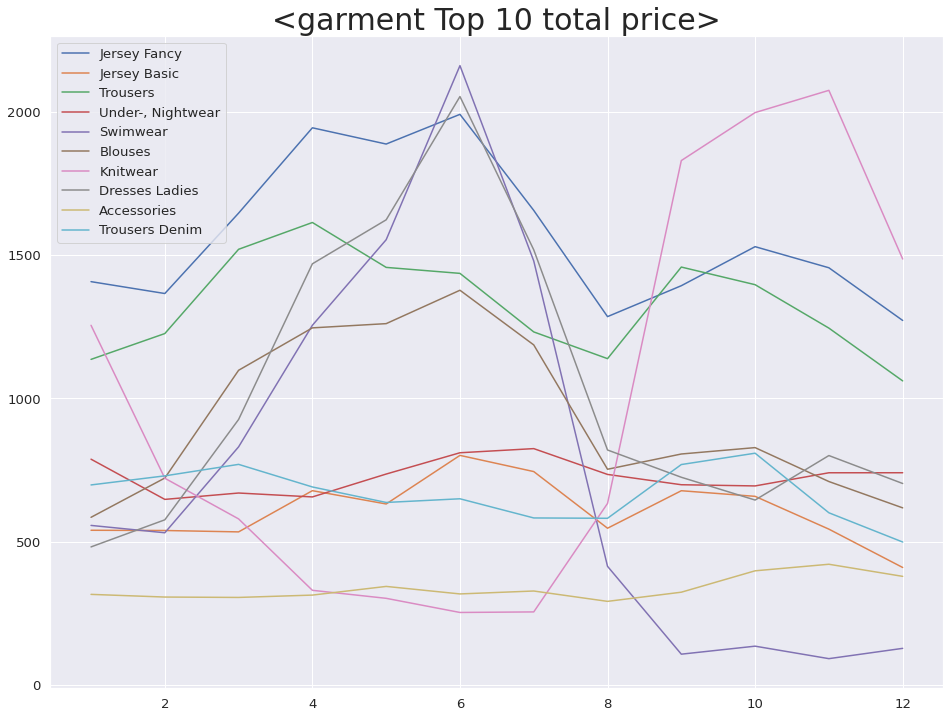

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(16, 12))

plt.title('<garment Top 10 total price>', fontsize=30)
plt.plot(garment_price_top10)
plt.legend(labels=garment_list_price_top_temp)

- Jersey 판매 수량은 압도적으로 높았음
- 판매 금액에 대해서는 계절성의 띄는 아이템이 때에 따라서 더 높은 판매금액을 가짐 (Swimwear, Knitwear)
- Jersey는 판매 단가가 비교적 쌈
- Swimwear와 Knitwear는 판매 단가가 비교적 비쌈

In [ ]:
df_garment_price_bottem10 = data.groupby(['garment_group_name']).size().sort_values(ascending=True).head(10)

garment_list_price_bottem_temp = []

for i in df_garment_price_bottem10.index:
    garment_list_price_bottem_temp.append(i)
    
garment_price_bottom10 = pvt_garment_price[garment_list_price_bottem_temp]
garment_price_bottom10

garment_group_name,Woven/Jersey/Knitted mix Baby,Dresses/Skirts girls,Shirts,Special Offers,Dressed,Unknown,Skirts,Socks and Tights,Outdoor,Shoes
month,,,,,,,,,,
1,23.874153,19.150356,51.912136,126.445322,242.576017,365.164661,141.755966,111.027576,684.558458,368.429780
2,26.811254,25.336051,67.683949,64.589678,276.980881,286.315051,199.043525,104.214356,591.871508,289.279780
3,15.342780,18.804186,61.770525,52.374102,331.894627,408.783186,237.637169,94.030492,571.666814,382.254593
4,14.503627,22.158542,77.277746,189.380610,295.435695,256.484729,290.059000,87.378220,411.247729,490.184644
5,11.975695,16.973051,98.752915,136.054780,255.645814,174.743542,306.948593,86.812153,330.631576,466.932458
6,11.333068,18.774119,102.240780,63.342373,164.581390,211.263949,385.049424,68.468559,214.434915,481.023424
7,12.284881,14.924220,81.875186,47.603780,135.923169,187.157000,319.208475,60.910644,226.370237,414.840525
8,11.970695,8.600627,55.366542,61.280610,253.560424,177.428356,264.355153,59.303695,417.143763,348.075475
9,13.976864,9.393847,65.311593,243.659322,408.410237,392.857983,301.975153,113.374661,1120.689339,401.246559


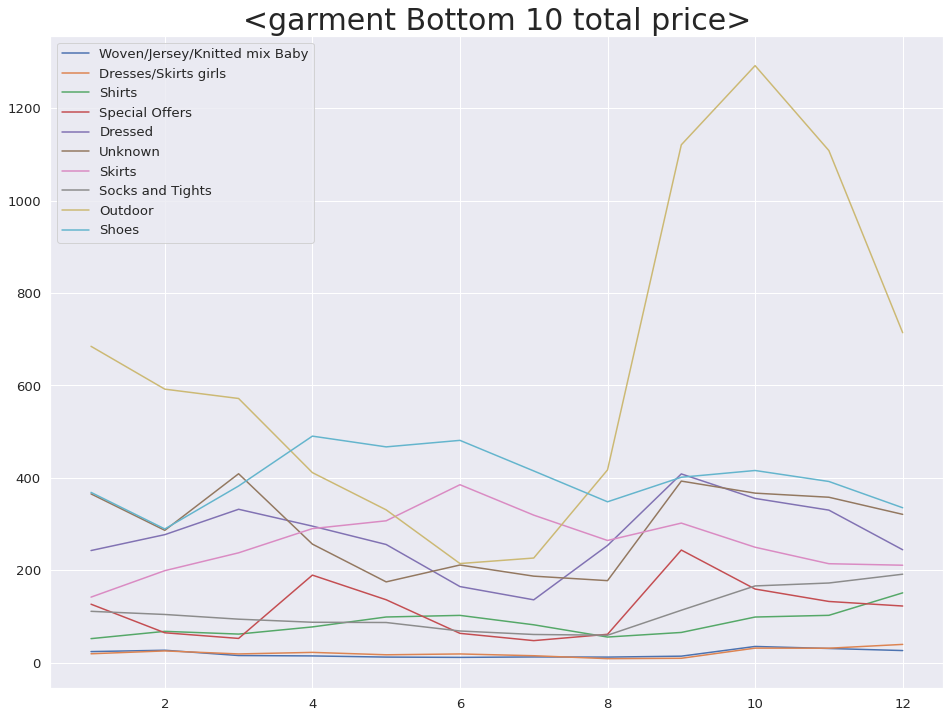

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(16, 12))

plt.title('<garment Bottom 10 total price>', fontsize=30)
plt.plot(garment_price_bottom10)
plt.legend(labels=garment_list_price_bottem_temp)

In [ ]:
print('상위 10개의 총 판매 금액: {:3,.2f}'.format(garment_price_top10.sum().sum()))
print('하위 10개의 총 판매 금액 : {:3,.2f}'.format(garment_price_bottom10.sum().sum()))

상위 10개의 총 판매 금액: 107,398.19
하위 10개의 총 판매 금액 : 26,607.68


In [ ]:
print('전체 중, 상위 10개 아이템이 차지하는 금액 비율 : {:.2f}%'.format(garment_price_top10.sum().sum() / data['price'].sum() * 100))
print('전체 중, 하위 10개 아이템이 차지하는 금액 비율 : {:.2f}%'.format(garment_price_bottom10.sum().sum() / data['price'].sum() * 100))

전체 중, 상위 10개 아이템이 차지하는 금액 비율 : 78.34%
전체 중, 하위 10개 아이템이 차지하는 금액 비율 : 19.41%


### 📌Index Goup Name 

In [ ]:
data['index_group_name'].unique()

array(['Ladieswear', 'Divided', 'Menswear', 'Baby/Children', 'Sport'],
      dtype=object)

#### 1.index_group별 판매 수량

In [ ]:
pvt_index_size = pd.pivot_table(data=data, index='month', columns='index_group_name', values='customer_id', aggfunc='size')
pvt_index_size

index_group_name,Baby/Children,Divided,Ladieswear,Menswear,Sport
month,,,,,
1,27543,86382,225171,16659,19360
2,25355,79238,206465,17129,14565
3,14710,90258,246009,16029,14987
4,15714,93196,294833,20992,14154
5,11781,93973,319176,23644,14798
6,13596,122027,384413,30916,15710
7,12592,124227,353007,30772,16291
8,10293,91648,235447,18760,15301
9,12299,89420,225317,19414,16029


In [ ]:
data.groupby(['index_group_name']).size().sort_values(ascending=False)

index_group_name
Ladieswear       3138692
Divided          1132169
Menswear          271043
Baby/Children     248431
Sport             181443
dtype: int64

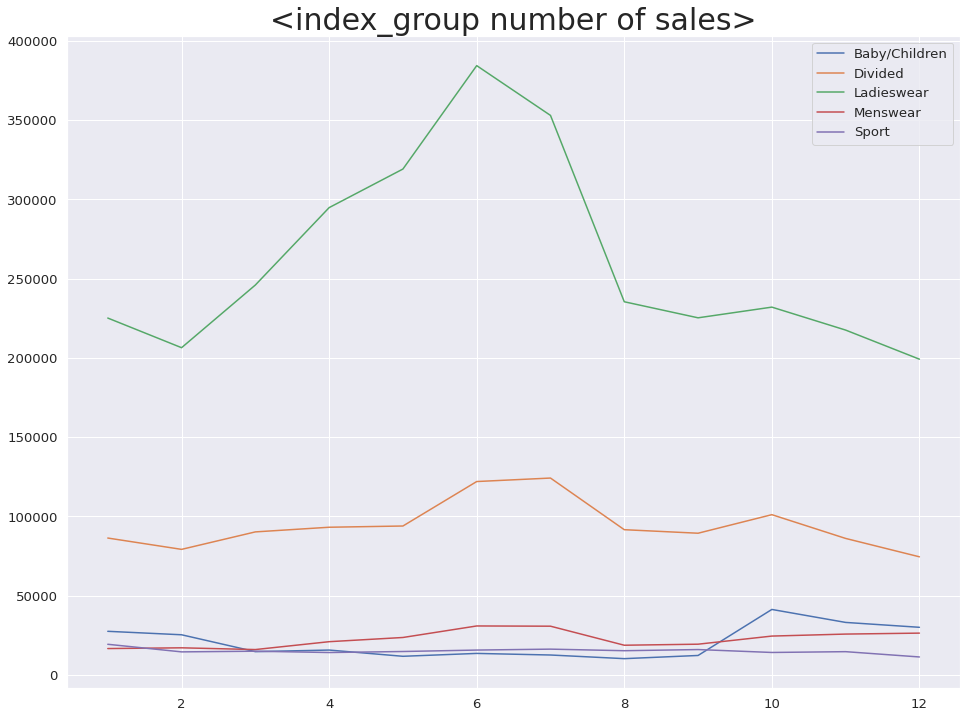

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(16, 12))

plt.title('<index_group number of sales>', fontsize=30)
plt.plot(pvt_index_size)
plt.legend(labels=pvt_index_size)

In [ ]:
print('전체 아이템 중, "Ladieswear"의 판매 비율 : {:.2f}%'.format(len(data[data['index_group_name'] == 'Ladieswear']) / len(data) * 100))
print('전체 아이템 중, "Sport"의 판매 비율 : {:.2f}%'.format(len(data[data['index_group_name'] == 'Sport']) / len(data) * 100))

전체 아이템 중, "Ladieswear"의 판매 비율 : 63.13%
전체 아이템 중, "Sport"의 판매 비율 : 3.65%


- H&M에서는 여성 고객의 비중이 매우 매우 높음
- Sport, 어린이, 남성의류는 적은 비율을 차지함

#### 2.index_group 판매 금액 
##### 2-1.index_group 총 판매금액 

In [ ]:
pvt_index_price = pd.pivot_table(data=data, index='month', columns='index_group_name', values='price', aggfunc='sum')
pvt_index_price

index_group_name,Baby/Children,Divided,Ladieswear,Menswear,Sport
month,,,,,
1,503.288508,2192.170475,6222.360305,480.240576,540.727017
2,467.333831,2176.218644,5797.902288,492.082864,420.761847
3,281.299356,2520.465441,7428.153475,468.450508,453.916424
4,296.446881,2578.858458,8866.829475,580.765780,408.546458
5,219.884746,2506.140593,9058.519441,652.212373,426.886847
6,226.487729,2920.338678,10188.103983,743.233186,406.901593
7,182.040288,2568.030525,8232.893847,649.028424,386.095119
8,170.984305,2102.620898,5929.147593,455.829831,404.511271
9,279.148678,2676.868847,7825.450559,632.460492,499.318475


In [ ]:
data.groupby(['index_group_name'])['price'].sum().sort_values(ascending=False)

index_group_name
Ladieswear       90143.474847
Divided          29605.462068
Menswear          7474.449898
Sport             5144.764780
Baby/Children     4720.173085
Name: price, dtype: float64

In [ ]:
print('전체 아이템 중, "Ladieswear"의 총 판매 금액 비율 : {:.2f}%'.format(data[data['index_group_name'] == 'Ladieswear']['price'].sum() / data['price'].sum() * 100))
print('전체 아이템 중, "Baby/Children"의 총 판매 금액 비율 : {:.2f}%'.format(data[data['index_group_name'] == 'Baby/Children']['price'].sum() / data['price'].sum() * 100))

전체 아이템 중, "Ladieswear"의 총 판매 금액 비율 : 65.76%
전체 아이템 중, "Baby/Children"의 총 판매 금액 비율 : 3.44%


- 전체 판매 금액 중, 여성 의류 판매 금액 비율이 매우 높음

##### 2-2. index_group 판매 금액 평균

In [ ]:
pvt_index_price_mean = pd.pivot_table(data=data, index='month', columns='index_group_name', values='price', aggfunc='mean')
pvt_index_price_mean

index_group_name,Baby/Children,Divided,Ladieswear,Menswear,Sport
month,,,,,
1,0.018273,0.025378,0.027634,0.028828,0.027930
2,0.018432,0.027464,0.028082,0.028728,0.028889
3,0.019123,0.027925,0.030195,0.029225,0.030287
4,0.018865,0.027671,0.030074,0.027666,0.028864
5,0.018664,0.026669,0.028381,0.027585,0.028848
6,0.016658,0.023932,0.026503,0.024040,0.025901
7,0.014457,0.020672,0.023322,0.021092,0.023700
8,0.016612,0.022942,0.025183,0.024298,0.026437
9,0.022697,0.029936,0.034731,0.032578,0.031151


In [ ]:
data.groupby(['index_group_name'])['price'].mean().sort_values(ascending=False)

index_group_name
Ladieswear       0.028720
Sport            0.028355
Menswear         0.027577
Divided          0.026149
Baby/Children    0.019000
Name: price, dtype: float64

#### 3.index_group별 판매 금액 비교

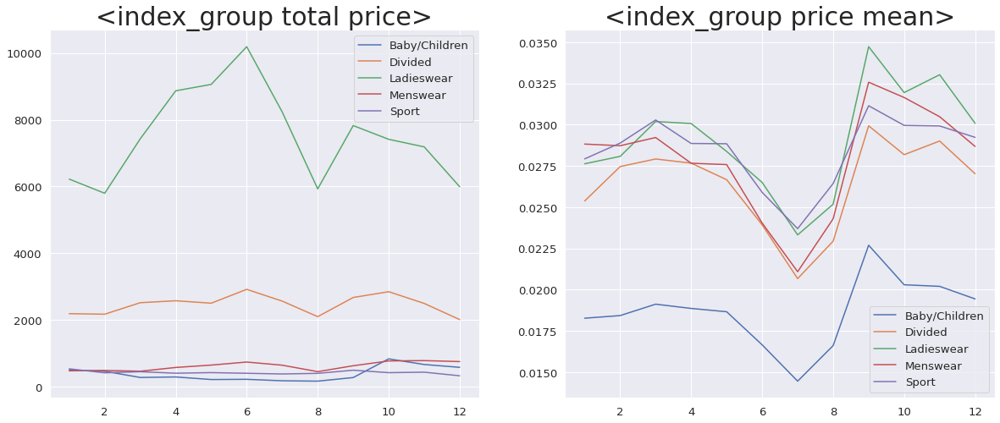

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)
plt.title('<index_group total price>', fontsize=30)
plt.plot(pvt_index_price)
plt.legend(labels=pvt_index_price)

plt.subplot(1,2,2)
plt.title('<index_group price mean>', fontsize=30)
plt.plot(pvt_index_price_mean)
plt.legend(labels=pvt_index_price_mean)

- 여성 의류의 총 판매 금액 비율이 다른 아이템보다 높음
- 여성 고객의 비율이 많을 것으로 판단됨
- H&M에서의 Sport 의류는 비교적 싼 단가를 보임

### 📌Club Member Status

- 멤버쉽 가입 여부에 의한 Feature

In [ ]:
data['club_member_status'].unique()

array(['ACTIVE', 'PRE-CREATE', 'LEFT CLUB'], dtype=object)

- ACTIVE : 현재 회원
- PRE-CREATE : 회원 가입 전 고객
- LEFT CLUB : 회원 탈퇴 고객

### 1.클럽 멤버쉽별 아이템 구매

In [ ]:
data.groupby(['club_member_status', 'index_group_name'])['price'].sum()

club_member_status  index_group_name
ACTIVE              Baby/Children        4445.944627
                    Divided             28860.579508
                    Ladieswear          87879.940186
                    Menswear             7293.025746
                    Sport                4974.264508
LEFT CLUB           Baby/Children           1.421322
                    Divided                10.148186
                    Ladieswear             38.715932
                    Menswear                1.908678
                    Sport                   1.701441
PRE-CREATE          Baby/Children         272.807136
                    Divided               734.734373
                    Ladieswear           2224.818729
                    Menswear              179.515475
                    Sport                 168.798831
Name: price, dtype: float64

In [ ]:
print('현재 H&M 회원 수 : {:3,d}'.format(data[data['club_member_status'] == 'ACTIVE']['customer_id'].nunique()))
print('현재 H&M 회원이 구매한 수 : {:3,d}'.format(len(data[data['club_member_status'] == 'ACTIVE'])))
print('현재 H&M 회원의 구매 금액 : {:3,.2f}'.format(data[data['club_member_status'] == 'ACTIVE']['price'].sum()))

현재 H&M 회원 수 : 757,691
현재 H&M 회원이 구매한 수 : 4,850,004
현재 H&M 회원의 구매 금액 : 133,453.75


In [ ]:
print('현재 H&M 비회원 수 : {:3,d}'.format(data[data['club_member_status'] == 'PRE-CREATE']['customer_id'].nunique()))
print('현재 H&M 비회원이 구매한 수 : {:3,d}'.format(len(data[data['club_member_status'] == 'PRE-CREATE'])))
print('현재 H&M 회원의 구매 금액 : {:3,.2f}'.format(data[data['club_member_status'] == 'PRE-CREATE']['price'].sum()))

현재 H&M 비회원 수 : 43,283
현재 H&M 비회원이 구매한 수 : 119,984
현재 H&M 회원의 구매 금액 : 3,580.67


In [ ]:
print('현재 H&M 탈퇴 회원 수 : {:3,d}'.format(data[data['club_member_status'] == 'LEFT CLUB']['customer_id'].nunique()))
print('현재 H&M 탈퇴 회원이 구매한 수 : {:3,d}'.format(len(data[data['club_member_status'] == 'LEFT CLUB'])))
print('현재 H&M 회원의 구매 금액 : {:3,.2f}'.format(data[data['club_member_status'] == 'LEFT CLUB']['price'].sum()))

현재 H&M 탈퇴 회원 수 : 270
현재 H&M 탈퇴 회원이 구매한 수 : 1,790
현재 H&M 회원의 구매 금액 : 53.90


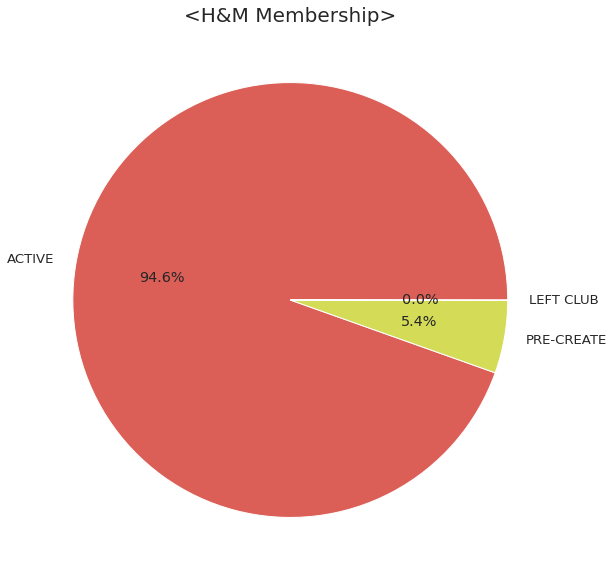

In [ ]:
ratio = [data[data['club_member_status'] == 'ACTIVE']['customer_id'].nunique(), 
         data[data['club_member_status'] == 'PRE-CREATE']['customer_id'].nunique(), 
         data[data['club_member_status'] == 'LEFT CLUB']['customer_id'].nunique()]
labels = ['ACTIVE', 'PRE-CREATE', 'LEFT CLUB']

fig=plt.figure(figsize=(10,10))
plt.title('<H&M Membership>', fontsize=20)

colors = sns.color_palette('hls')

plt.pie(ratio, labels=labels, autopct='%.1f%%', colors=colors)
plt.rc('font', size=15)

#### 2.클럽 멤버쉽별 온오프라인 구매 비교

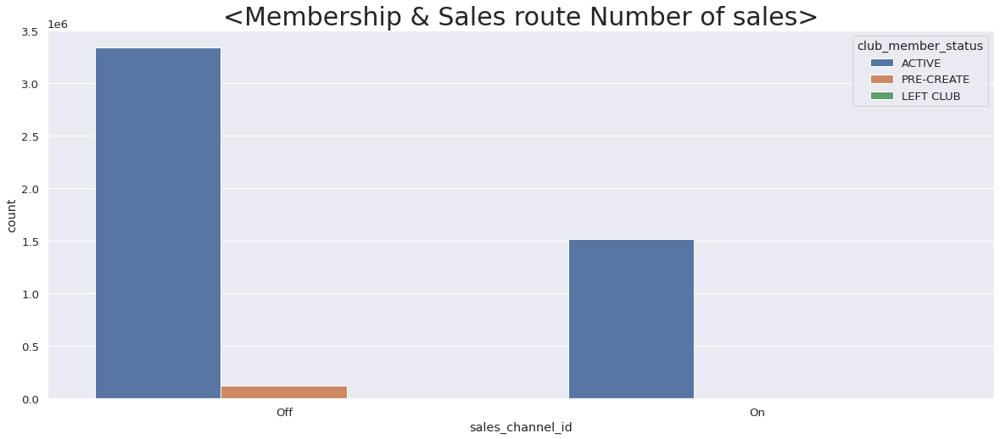

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 8))

plt.title('<Membership & Sales route Number of sales>', fontsize=30)
sns.countplot(data=data, x='sales_channel_id', hue='club_member_status')

In [ ]:
data.groupby(['sales_channel_id', 'club_member_status'])['customer_id'].count()

sales_channel_id  club_member_status
Off               ACTIVE                3336510
                  LEFT CLUB                1687
                  PRE-CREATE             119756
On                ACTIVE                1513494
                  LEFT CLUB                 103
                  PRE-CREATE                228
Name: customer_id, dtype: int64

#### 3.3. 클럽 멤버쉽별 연령 비교

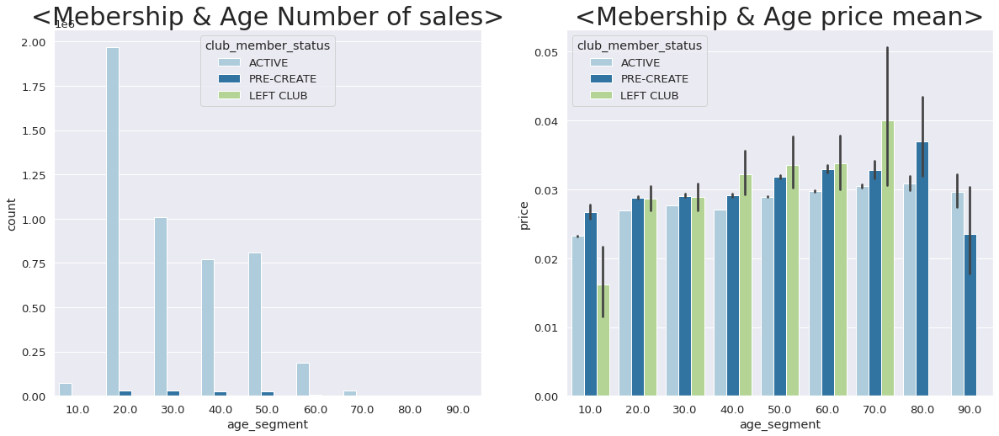

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)
plt.title('<Mebership & Age Number of sales>', fontsize=30)
sns.countplot(data=data, x='age_segment', hue='club_member_status', palette='Paired')

plt.subplot(1,2,2)
plt.title('<Mebership & Age price mean>', fontsize=30)
sns.barplot(data=data, x='age_segment', hue='club_member_status', y='price', palette='Paired')

- 20대 멤버쉽 가입 회원이 가장 많음 (H&M에서는 20대 고객의 비율이 가장 높음)
- 멤버쉽 가입을 유지하는 회원에 비해서 멤버쉽 탈퇴하는 고객의 비율은 현저하게 낮음  
(회원 탈퇴 후에는 멤버쉽 가입 여부를 알 수 없기 때문에 마지막 구매 시점에서의 탈퇴 여부만 파악되는 것으로 예상됨)
- 대체로 멤버쉽 탈퇴 당시 비싼 아이템을 구매하는 것으로 판단됨

In [ ]:
data.groupby(['club_member_status', 'age_segment'])['customer_id'].count()

club_member_status  age_segment
ACTIVE              10.0             70742
                    20.0           1967305
                    30.0           1007860
                    40.0            771541
                    50.0            810801
                    60.0            187622
                    70.0             31532
                    80.0              2379
                    90.0               222
LEFT CLUB           10.0                10
                    20.0               701
                    30.0               556
                    40.0               154
                    50.0               227
                    60.0                98
                    70.0                44
PRE-CREATE          10.0               927
                    20.0             30833
                    30.0             29480
                    40.0             25021
                    50.0             26097
                    60.0              6236
                    70

### 📌Fashion_News_Frequency


- Fashion News를 수령에 관한 Feature

In [ ]:
data['fashion_news_frequency'].unique()

array(['NONE', 'Regularly', 'Monthly'], dtype=object)

- NONE : Fashion News를 받지 않는 고객
- Regularly : 정기적으로 Fashion News를 받는 고객으로 예상됨
- Monthly : 매월 Fashion News를 받는 고객으로 예상됨 (충성도가 높은 고객으로 예상됨)

#### 1. 패션 뉴스 수신 여부별 온/오프라인 비교

In [ ]:
data.groupby(['fashion_news_frequency', 'sales_channel_id'])['price'].sum()

fashion_news_frequency  sales_channel_id
Monthly                 Off                    27.618051
                        On                     27.655254
NONE                    Off                 59638.553186
                        On                  19410.053593
Regularly               Off                 42780.735220
                        On                  15203.709373
Name: price, dtype: float64

In [ ]:
data.groupby(['fashion_news_frequency', 'sales_channel_id'])['customer_id'].size()

fashion_news_frequency  sales_channel_id
Monthly                 Off                     953
                        On                     1220
NONE                    Off                 2006972
                        On                   843257
Regularly               Off                 1450028
                        On                   669348
Name: customer_id, dtype: int64

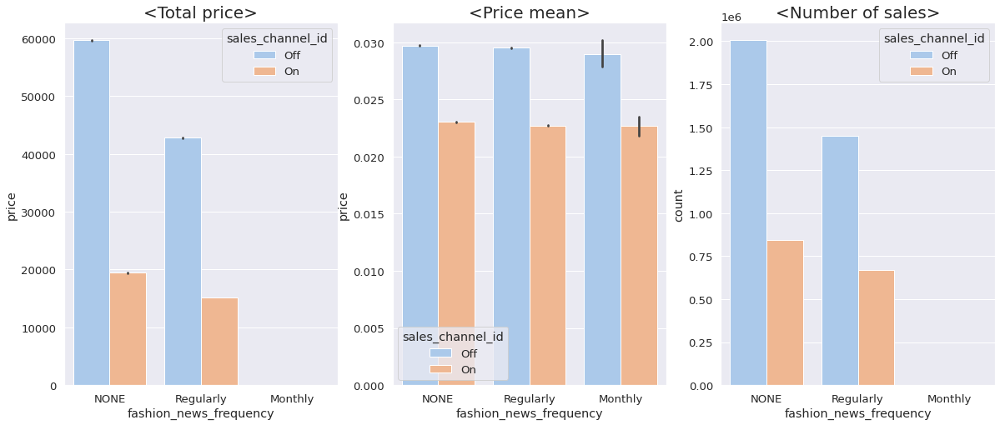

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 8))

plt.subplot(1,3,1)
plt.title('<Total price>', fontsize=20)
sns.barplot(data=data, x='fashion_news_frequency', hue='sales_channel_id', y='price', estimator=np.sum, palette='pastel')

plt.subplot(1,3,2)
plt.title('<Price mean>', fontsize=20)
sns.barplot(data=data, x='fashion_news_frequency', hue='sales_channel_id', y='price', palette='pastel')

plt.subplot(1,3,3)
plt.title('<Number of sales>', fontsize=20)
sns.countplot(data=data, x='fashion_news_frequency', hue='sales_channel_id', palette='pastel')

- Fashion News를 매월 받아보는 고객의 비율은 매우 낮음
- Fashion News 수령과 관계없이 고객들의 구매 단가는 비슷한 양상을 띔

#### 2. 패션 뉴스 수신 여부별 멤버쉽 비교

In [ ]:
pvt_freq_status = pd.pivot_table(data=data, index='club_member_status', columns='fashion_news_frequency', values='price', aggfunc='sum')

In [ ]:
pvt_freq_status.T

club_member_status,ACTIVE,LEFT CLUB,PRE-CREATE
fashion_news_frequency,,,
Monthly,52.834034,NaN,2.439271
NONE,75691.285949,53.514610,3303.806220
Regularly,57709.634593,0.380949,274.429051


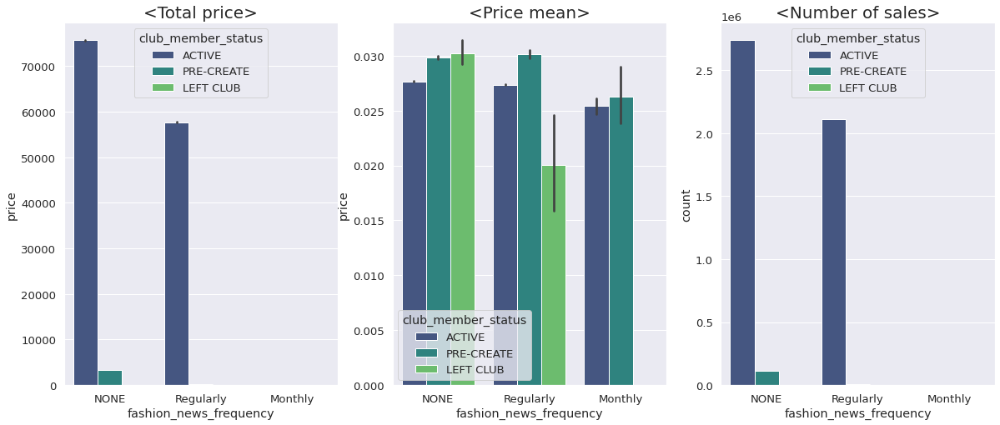

In [ ]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 8))

plt.subplot(1,3,1)
plt.title('<Total price>', fontsize=20)
sns.barplot(data=data,x='fashion_news_frequency', y = 'price',hue='club_member_status', estimator=np.sum, palette='viridis')

plt.subplot(1,3,2)
plt.title('<Price mean>', fontsize=20)
sns.barplot(data=data,x='fashion_news_frequency', y = 'price',hue='club_member_status', palette='viridis')

plt.subplot(1,3,3)
plt.title('<Number of sales>', fontsize=20)
sns.countplot(data=data, x='fashion_news_frequency', hue='club_member_status', palette='viridis')

- Fashion News를 매월 받아보는 고객의 비율은 매우 낮음
- 멤버쉽을 탈퇴한 고객은 비교적 높은 구매 단가를 보였으나 Regulary에 해당하는 고객 중 멤버쉽 탈퇴 고객은 비교적 낮은 구매 단가를 보임
- Monthly에 해당하는 고객 중 멤버쉽 탈퇴 고객의 구매 단가는 0임  
(Monthly에 해당하는 고객은 멤버쉽 탈퇴를 하지 않은 것으로 판단됨)

### 📌 Postal Code 시각화 
- 고객정보 보호를 위해 postal_code가 암호화 되어 있으나 어느 지역에서 얼만큼 구매하는지는 기업에 있어 중요한 요소일 수 있으므로 물품을 1000개 이상산 지역과 100개 이상 10000개 미만으로 산 지역과 10개에서 100개 미만으로 산지역 그리고 10개 미만으로 제품을 구매한 지역을 구분했습니다.  
- Postal_code with customer_size > 100 & <10000: big city  
- Postal_code with customer_size > 10 & <100: medium city  
-Postal_code with customer_size <10: small city    

- 예를들어 2c29ae653a9282cce4151bd87643c907644e09541abc28ae87dea0d1f6603b1c 지역에서 구매한 개수는 79116으로 가장 많아 이 우편번호의 지역에 거주하는 주민이 가장 많이 H&M을 구매함

In [ ]:
area = data.postal_code.value_counts().reset_index()
area['bins'] = pd.cut(area['postal_code'], bins=[-1, 10, 100, 1e4], include_lowest=True) #데이터를 구간으로 분할 
area.head(5)

,index,postal_code,bins
0,2c29ae653a9282cce4151bd87643c907644e09541abc28...,79116,NaN
1,a5ca21aefc3cf90afd9b09faf3b0f8f3c423d4f1cfb4c2...,1219,"(100.0, 10000.0]"
2,1f5bd429acc88fbbf24de844a59e438704aa8761bc7b99...,918,"(100.0, 10000.0]"
3,7c1fa3b0ec1d37ce2c3f34f63bd792f3b4494f324b6be5...,882,"(100.0, 10000.0]"
4,2790324c84cdb8ba471be2a199cfb5103bbe1ab10883a0...,774,"(100.0, 10000.0]"


In [ ]:
temp_area = area[['postal_code', 'bins']] #postal_code와 bins만 따로 뽑아 데이터 프레임으로 만들기 
temp_area['bins'].unique() #bins열 유니크 값 확인 

[NaN, (100.0, 10000.0], (10.0, 100.0], (-1.001, 10.0]]
Categories (3, interval[float64, right]): [(-1.001, 10.0] < (10.0, 100.0] < (100.0, 10000.0]]

lst 값 확인:[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


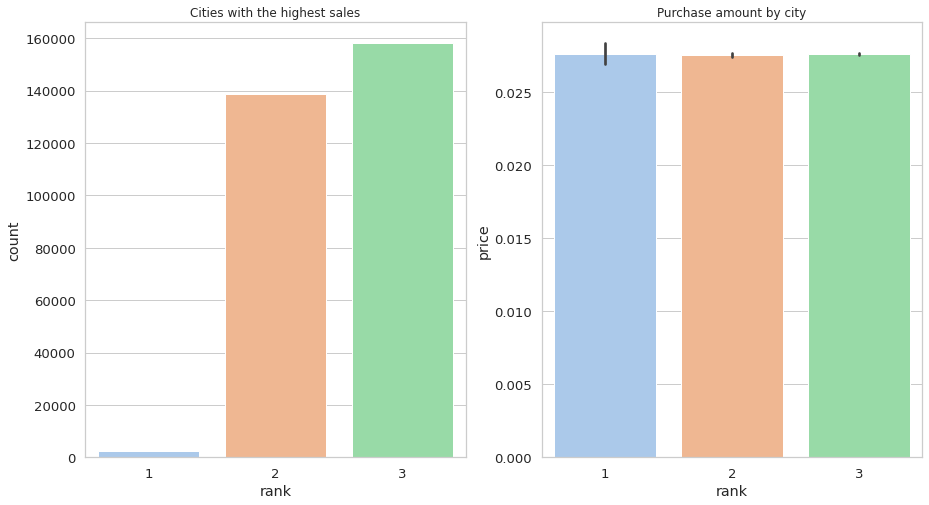

In [ ]:
#temp_area = temp_area.drop([0],axis=0) #NaN 값 가진 행 삭제

lst = [] #많이 산 지역을 순위별로 저장 10, 100로 구분  
for code in temp_area['postal_code']: 
  if code > 100: #100개 이상 산지역
    lst.append(1)

  elif code > 10: #10개 이상 산지역 
    lst.append(2)

  else: #10개 미만 
    lst.append(3)

print("lst 값 확인:{}".format(lst[:30])) #순위가 잘 들어갔는지 확인 

print("========================================================================================")
temp_area['rank'] = lst #'rank' 열 생성 
temp_area = temp_area[['postal_code', 'rank']] 
temp_area.head(-2)

#물품을 가장 많이 산지역 1,2,3 위 순으로 시각화
sns.set_style("whitegrid") 
f, axes = plt.subplots(1,2,figsize=(15,8))
#plt.figure(figsize = (15,8))
axes[0].set_title('Cities with the highest sales', fontsize = 12)
sns.countplot(data=temp_area, x='rank', palette="pastel",ax = axes[0])

#지역별로 평균적으로 구매한 물품의 가격 시각화 
temp_area['price'] = data['price']
#plt.figure(figsize = (15,8))
axes[1].set_title('Purchase amount by city', fontsize = 12)
sns.barplot(data=temp_area, x='rank', y='price', estimator=np.mean, palette="pastel", ax = axes[1])

☆시각화 결과  
1. h&m을 100개 이상 10000개 미만 구매한 지역보다 10개 이상 100개 미만 그리고 10개 미만의 소수의 아이템을 구매한 지역이 훨씬 많음  
  - 이는 h&m의 구매자들이 다양한 지역에 골고루 분포해 있음을 알 수 있음  
2. big city , medium city , small city의 구매금액은 비슷함 


In [ ]:
def change_value(series):
  lst2 = []
  for value in series:
    if value == "On":
      lst2.append(1)
    elif value == "Off":
      lst2.append(2)

  return lst2

series = data['sales_channel_id'] #On을 1로 Off를 2로 변경 
on_or_off = change_value(series)
data['sales_channel_id_to_number'] = on_or_off 

In [ ]:
temp_area['sales_channel_id'] = data['sales_channel_id_to_number'] #1: online, 2:offline 
temp_area.head(2)

,postal_code,rank,price,sales_channel_id
0,79116,1,0.030492,2
1,1219,1,0.067780,2


Text(0.5, 1.0, 'Purchase amount by city')

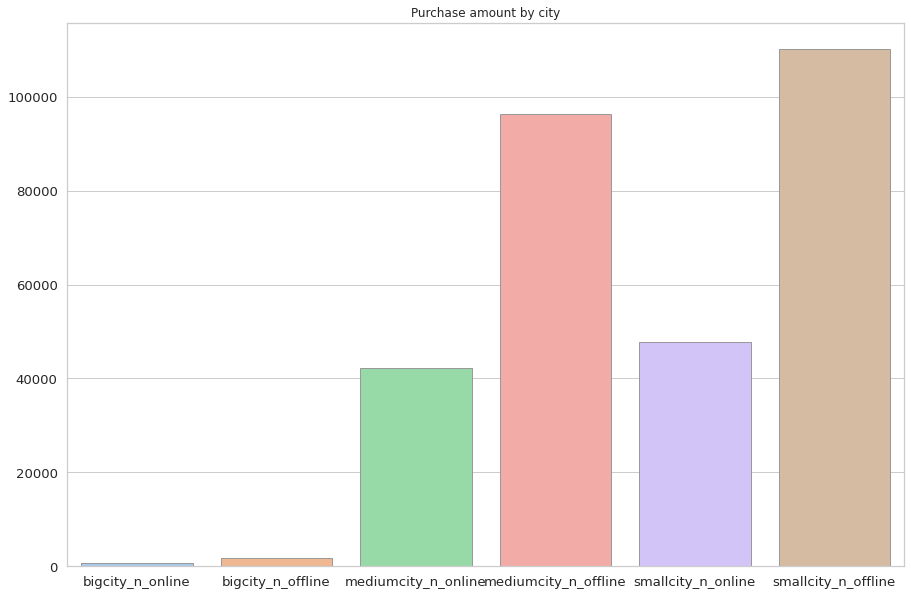

In [ ]:
bigcity_n_online = temp_area.loc[(temp_area['rank'] == 1) & (temp_area['sales_channel_id'] == 1)].shape[0] #rank:1, online
bigcity_n_offline = temp_area.loc[(temp_area['rank'] == 1) & (temp_area['sales_channel_id'] == 2)].shape[0] #rank:1, offline
mediumcity_n_online = temp_area.loc[(temp_area['rank'] == 2) & (temp_area['sales_channel_id'] == 1)].shape[0] #rank:2, online
mediumcity_n_offline= temp_area.loc[(temp_area['rank'] == 2) & (temp_area['sales_channel_id'] == 2)].shape[0] #rank:2, offline
smallcity_n_online = temp_area.loc[(temp_area['rank'] == 3) & (temp_area['sales_channel_id'] == 1)].shape[0] #rank:3, online
smallcity_n_offline = temp_area.loc[(temp_area['rank'] == 3) & (temp_area['sales_channel_id'] == 2)].shape[0] #rank:3, offline

city_n_onoff = pd.DataFrame({"bigcity_n_online":bigcity_n_online,
                     "bigcity_n_offline":bigcity_n_offline,
                     "mediumcity_n_online":mediumcity_n_online,
                     "mediumcity_n_offline":mediumcity_n_offline,
                     "smallcity_n_online":smallcity_n_online,
                     "smallcity_n_offline":smallcity_n_offline
                     }, index=[0, 1, 2, 3, 4, 5])

plt.figure(figsize = (15,10))
s = sns.barplot(data=city_n_onoff, palette="pastel", edgecolor=".6")
s.set_title('Purchase amount by city', fontsize = 12)

☆시각화 결과
- 구매력이 크든 적든 모든 지역에서 offline 구매가 더 많았고 그 중에서도 small city의 offline 구매가 가장 많았음
- 아마도 번화가에 주로 H&M이 많고 쇼핑하는 김에 H&M에 방문한 경우 위주로 구매한 것으로 예상됨

### &#128204;계절성(seasonality)을 띄는 제품을 PCA와 Clustering을 활용한 시각화  
- 계절성을 띄는 대표적인 상품으로 knitwear, swimwear 등이 있습니다. 이를 PCA와 Clustering으로 시각화하여 비슷한 계절성을 띄는 제품군끼리 군집화함  
- H&M 의류는 index_group_name(대분류) -> garment_group_name(소분류)로 갈수록 상세하게 의류를 분류함
- 따라서 index_group_name -> garment_group_name -> age_segment(연령대)를 한번에 확인 가능한 컬럼('idx_garment_age')을 별도로 생성함  
- 시각화 한 자료를 보시면 Ladieswear_Knitwear_20.0를 기준으로 다른 컬럼과의 유사도를 파악할 수 있음
- 여기서 Ladieswear_Knitwear_20.0란 Ladieswear중 knitwear를 구매한 20대라는 뜻
- Ladieswear_Knitwear_20.0을 기준점으로 삼은 이유는 H&M의 대다수 고객이 여성이고 니트류는 가을과 겨울에 가장 많이 팔리는 상품이며 연령대 중에서도 20대 고객이 가장 많기 때문에 H&M을 대표할 수 있는 상품이라 판단함




In [ ]:
data['year_month'] = data['year_month'].astype(str) #str로 변경 
data['y'] = data['year_month'].str[:4] #20191008 -> 2019년도만 가져옴 
data['genreation'] = data['age_segment'].astype(str) #연령대 컬럼 새로생성 age_segment str로 변경 
data['idx_garment_age'] = data['index_group_name'] + '_' + data['garment_group_name'] + '_' + data['age_int'] #Baby/Children_Accessories_10.0 요런 형식이 되도록 변형 

group1 = data.groupby(['idx_garment_age'])[['price']].sum().reset_index() #팔린 금액 합계로 goupby
group2 = data.groupby(['idx_garment_age', 'y', 'month'])[['price']].sum().reset_index() 
group2 = pd.merge(group2, group1, on='idx_garment_age', how='left') #idx_garment_age 기준으로 left join
group2['monthsales/ttl-sales'] = group2['price_x'] / group2['price_y'] * 100 #월별 판매금액/년도별 판매금액 
group2['date'] = group2['y'].astype(str) + '-' + group2['month'].astype(str) + '-1' #year + month + date
group2['date'] = pd.to_datetime(group2['date']) #datetime으로 변환 
group2 = pd.pivot_table(group2, index='date', columns='idx_garment_age', values='monthsales/ttl-sales').reset_index().fillna(0) #피봇 테이블로 변환
display(group2.head(2))

idx_garment_age,date,Baby/Children_Accessories_10.0,Baby/Children_Accessories_20.0,Baby/Children_Accessories_30.0,Baby/Children_Accessories_40.0,Baby/Children_Accessories_50.0,Baby/Children_Accessories_60.0,Baby/Children_Accessories_70.0,Baby/Children_Accessories_80.0,Baby/Children_Dresses/Skirts girls_10.0,...,Sport_Trousers_20.0,Sport_Trousers_60.0,Sport_Unknown_10.0,Sport_Unknown_20.0,Sport_Unknown_30.0,Sport_Unknown_40.0,Sport_Unknown_50.0,Sport_Unknown_60.0,Sport_Unknown_70.0,Sport_Unknown_80.0
0,2018-10-01,13.809354,13.397238,17.734748,23.922760,20.614982,17.226929,20.233258,0.000000,7.403116,...,100.0,0.0,3.179947,6.778185,10.141315,14.737998,10.538374,13.151403,10.643584,0.0
1,2018-11-01,13.727667,15.068214,20.301757,22.601702,20.401979,24.076664,21.039369,84.656652,8.577905,...,0.0,0.0,4.929967,8.557171,10.926801,12.695521,12.516945,12.790060,18.606226,0.0


In [ ]:
#line그래프로 시각화 
fig = px.line(group2, x='date', y=['Ladieswear_Blouses_50.0',
                                      'Ladieswear_Swimwear_60.0',
                                      'Menswear_Knitwear_30.0',
                                      'Ladieswear_Knitwear_20.0',
                                      'Divided_Knitwear_10.0',
                                      'Baby/Children_Accessories_40.0'], title="MothlySales / TTL sales")
fig.show()

- Ladieswear_Swimwear_60.0는 2019년 5월부터 2019년 7월까지 수영복을 많이 샀는데 이는 여름 휴가를 위한 수영복을 구매한 것이라 예상함  
- Divided_Knitwear_10.0는 가을과 겨울에 판매가 급증하는 것을 알 수 있음, Divided target층이 10대라 그런지 2019년 9월에는 세대보다 상품을 더 많이 구매함  


### 📌PCA(Principal Component Analysis)  
- 고차원의 데이터를 저차원의 데이터로 축소시키는 차원 축소 방법 중 하나  
- 여러 feature 중 가장 중요한 feature 몇 개만 선택해줌
- 차원 축소는 3차원이 넘어간 경우 시각화를 위해, 노이즈 제거, 메모리 절약, 불필요한 feature들을 제거해 모델 성능 향상에 기여  
- group2의 shape은 (12, 596), 컬럼수만 596개 이므로 차원축소를 했음.

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

extract_columns = [col for col in group2.columns if col != 'date'] #date 컬럼을 제외한 컬럼명 추출 

data_pca = StandardScaler().fit_transform(group2[extract_columns]) #standardscaler 사용, 평균과 표준편차 사용 
model_pca = PCA(n_components=5) #PCA 객체 생성(주성분 갯수 5개 설정)
model_pca.fit(data_pca) #주성분 찾기
feature = model_pca.transform(data_pca) #새로운 주성분 

data_eigen = model_pca.components_.T #component_ 속성에 주성분 저장 
data_eigen = pd.DataFrame(data_eigen,
                        index=None,
                        columns=['PC1','PC2','PC3','PC4','PC5']) #데이터 프레임으로 변환 
data_eigen['idx_garment_age'] = extract_columns #추출한 열 값 저장 
data_eigen = pd.merge( #data_eigen과 Ladieswear_Knitwear_20.0의 상관계수 병합 
    data_eigen,
    group2.corr()[['Ladieswear_Knitwear_20.0']].reset_index().rename(columns={'Ladieswear_Knitwear_20.0': 'sales_indicator'}),
    on='idx_garment_age',
    how='left'
)
px.scatter(data_eigen, x='PC1', y='PC2', hover_name='idx_garment_age', color='sales_indicator') 

- sales_indicator의 수치가 클수록 유사도가 높고 노란색으로 표시됨  
- sales_indicator의 수치가 낮을수록 유사도가 낮고 진한색으로 표시됨  
- Ladieswear_Knitwear_20.0는 노란색으로 표시되고 주변의 노란색도 Ladieswear_Knitwear_30.0, 70.0으로 kintwear끼리 모여있음을 확인했음  
- 반면 Ladieswear_Swimwear_70.0은 정반대에 진한색으로 표시되어 있음  
- 해당 데이터를 활용하면 겨울에 20대 고객에게 니트웨어 말고도 그 주변에 있는 
Ladieswear_Outdoor를 추천할 수 있을 것으로 판단됨

### 📌GMM(Gaussian Mixture Models)/가우시안 혼합 모델  
- Gaussian 분포가 여러 개 혼합된 clustering 알고리즘  
- 복잡한 형태의 확률 분포를 K개의 Gaussian distribution을 혼합하여 표현하자는 것이 GMM의 기본 아이디어
- K는 데이터를 분석하고자 하는 사람이 직접 설정해야하는 하이퍼파라미터  
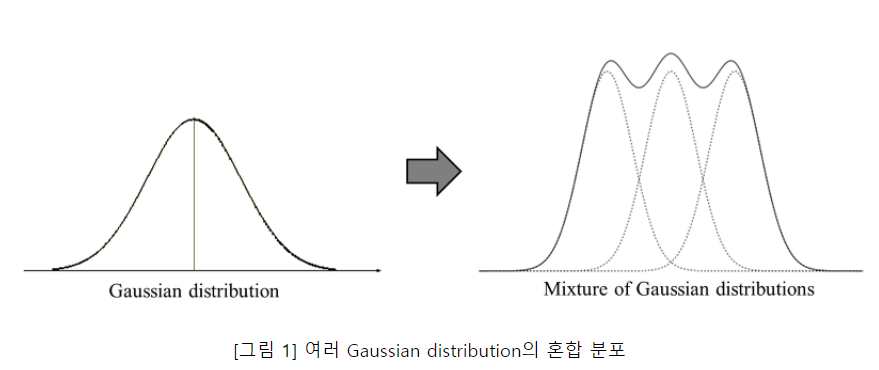

[GMM Reference](https://untitledtblog.tistory.com/133)

In [ ]:
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(n_components=4, covariance_type='full')#n_components 군집화할 개수 
gmm.fit(data_eigen[['PC1','PC2','PC3']])
data_eigen['product_seasonal_type'] = gmm.predict(data_eigen[['PC1','PC2','PC3']])
data_eigen['prob_cluster1'] = gmm.predict_proba(data_eigen[['PC1','PC2','PC3']])[:,0]
data_eigen['prob_cluster2'] = gmm.predict_proba(data_eigen[['PC1','PC2','PC3']])[:,1]
data_eigen['prob_cluster3'] = gmm.predict_proba(data_eigen[['PC1','PC2','PC3']])[:,2]
data_eigen['prob_cluster4'] = gmm.predict_proba(data_eigen[['PC1','PC2','PC3']])[:,3]
px.scatter(data_eigen, x='PC1', y='PC2', hover_name='idx_garment_age', color='product_seasonal_type')

- Gaussian Mixture Models과 PCA를 통한 분석은 비슷한 결과를 보임

## EDA를 통한 인사이트

- 기간별 아이템 실사 이미지를 보면서 주요 아이템들의 특징과 분류가 있다고 판단함
- 날짜, 연령, 구매 아이템, 회원 정보, 구매 경로 등으로 고객의 취향을 예측할 수 있다고 가정하고 본 프로젝트를 진행함
- EDA를 통해 각 Feature에서 여러 인사이트를 도출 할 수 있었음
- 여러 인사이트를 얻으며 새로운 고객에 대해서도 선호 아이템을 예상할 수 있을 것으로 판단됨
- 추가적인 PCA(주성분 분석)과 Gaussian Mixture Models을 통해 아이템에 대한 전반적인 분류와 상관관계가 있다고 판단함
<br><br>
- 이후 진행할 과정
  - 모델 구성을 고려하여 깊은 Feature engineering을 통해 각 Feature를 가공할 예정
  - EDA과정에서 확인했듯이 제품들은 계절성을 심하게 띄기 때문에 train val 데이터를 4분기로 나눠서 딥러닝 모델을(keras 이용) 구성할 계획
  - 모델을 학습하고 개선시켜 Kaggle 대회에 제출을 목표로 함